# NETW 1013 Clustering Project 

**Objective:** 
The objective of this project is to teach students how to apply clustering to real datasets.

You should be able to answer the following questions and provide reasonable justification for your answers: 
* Which clustering approach have you decided to use on each dataset? 
* Compare between Kmeans, Hierarchal and DBScan.
* Discuss how you tuned your clustering hyperparameters to achieve the best cluster assignment?
* What is the effect of different distance functions on the calculated clusters?
* How did you evaluate the performance of different clustering techniques on different datatsets?
* Visualize your output where applicable.
* What is the effect of scaling on the performance of clustering techniques? 

 
 



Running this project requires the following imports:

In [160]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
#from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
#from sklearn.preprocessing import StandardScaler

from sklearn.cluster import DBSCAN


from sklearn.cluster import KMeans

from sklearn.metrics import silhouette_score

%matplotlib inline
# Please refer to the sklearn documentation to learn more about the different parameters for each clustering technique.

In [108]:
# helper function that allows us to display data in 2 dimensions and highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmykw'  #List colors
    cmap = plt.get_cmap('tab20')
    alpha = 0.5  
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

## Multi Blob Data Set 
* The dataset generated below is known to be best clustered into 6 clusters.
* Cluster the data set below using the three different clustering techniques discussed in the course.
* Visualize your clustering output in each step of your work.



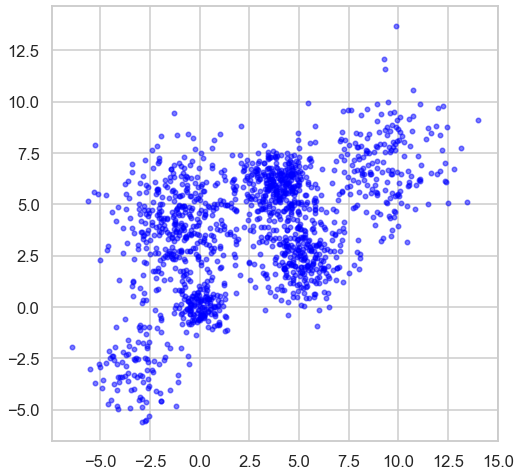

In [4]:
#Data Generation and Visualization
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data. 
* Display the outcome of each value of K. 
* Plot distortion function versus K and choose the approriate value of K. 
* Plot the silhouette_score versus K and use it to choose the best K. 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 
* Comment on the effect of centroid initialization on cluster assignment. 
* Hint: Lookup k-means++ .

In [110]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled_df = scaler.fit_transform(Multi_blob_Data)

In [161]:
from sklearn.cluster import KMeans

In [162]:
from sklearn.metrics import silhouette_score

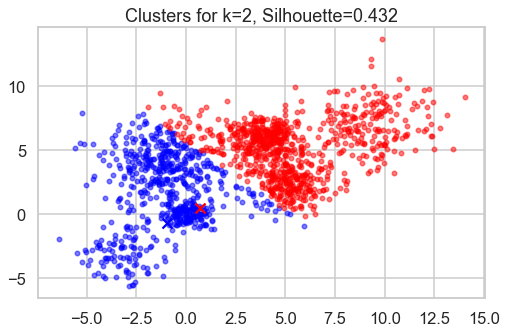

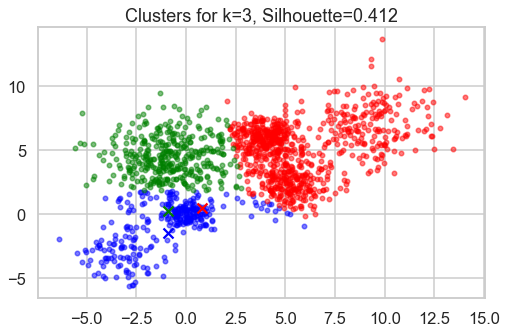

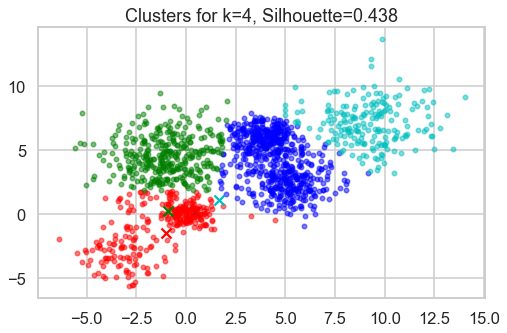

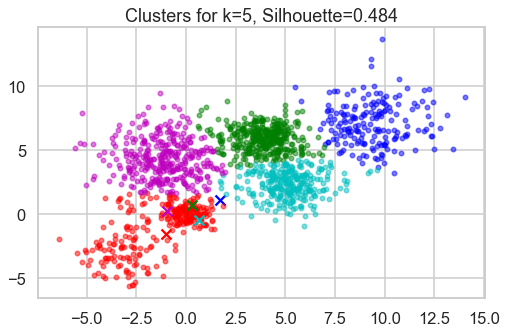

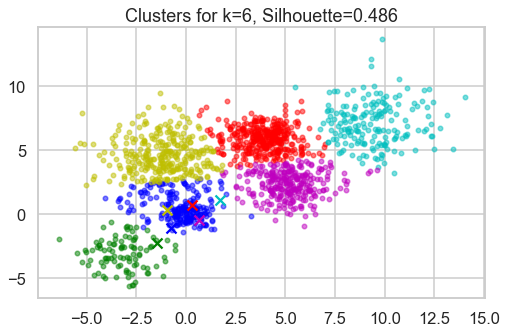

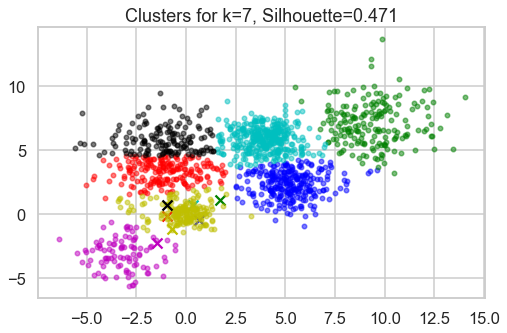

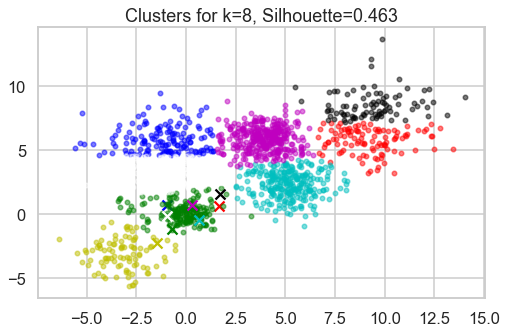

In [294]:
ssd = []
s=[]
best=-1
best_n=1

for k in range(2,9):
    
    model = KMeans(n_clusters=k)
    
    model.fit(scaled_df)
    silhouette=silhouette_score(scaled_df,model.labels_)#,metric='euclidean')
    s.append(silhouette)
    if silhouette >= best:
        best_n=k
        best =silhouette 
        #best_affinity=affinity
        #best_linkage=linkage
    
    #display_cluster(Multi_blob_Data, model, k)
    plt.figure(figsize=(8, 5))
    display_cluster(Multi_blob_Data, km=model, num_clusters=k)
    plt.title(f'Clusters for k={k}, Silhouette={silhouette:.3f}')
    plt.show()
    #Sum of squared distances of samples to their closest cluster center.
    ssd.append(model.inertia_)

0.4862522276594507


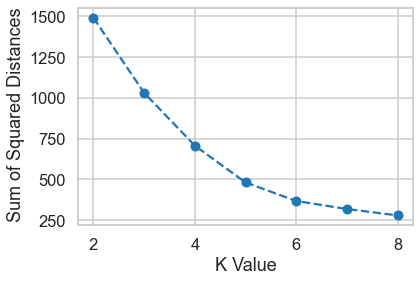

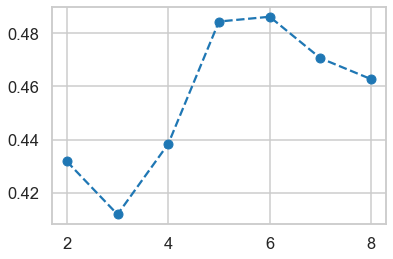

In [295]:
plt.plot(range(2,9),ssd,'o--')
plt.xlabel("K Value")
plt.ylabel(" Sum of Squared Distances")
plt.figure()
plt.plot(range(2,9),s,'o--')
print(best)

In [ ]:
# Centroid initialization may affect the solution the algorithm converges to
# Since the algorithm depends on minimizing a distortion function ...
# the initial point affects the minima it converges to which controls the number of clusters
# The K-means algorithm gave the expected result of 6 clusters as it gave the best silhouette score
# The silhouette was 0.4862522276594507

### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data.
* In the  AgglomerativeClustering change the following parameters:
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage(try different options)
    * Distance_threshold (try different options)
* Plot the dendrograph for one trial.
* For each of these trials, calculate the silhouette_score and display the resulting clusters.  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation.

In [11]:
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch

In [109]:
def display_scaled_cluster(X, labels=None):
    """Visualize scaled data with optional cluster labels"""
    plt.figure(figsize=(8,6))
    if labels is None:
        plt.scatter(X[:,0], X[:,1], alpha=0.7)
        plt.title("Scaled Data Distribution")
    else:
        for i in np.unique(labels):
            plt.scatter(X[labels == i,0], X[labels == i,1], 
                        alpha=0.7, label=f'Cluster {i+1}')
        plt.legend()
    plt.xlabel("Feature 1 (scaled)")
    plt.ylabel("Feature 2 (scaled)")
    plt.show()

Silhouette Score for affinity=euclidean, linkage=average, distance_threshold=10: 0.41009774740033655, n_clusters=6


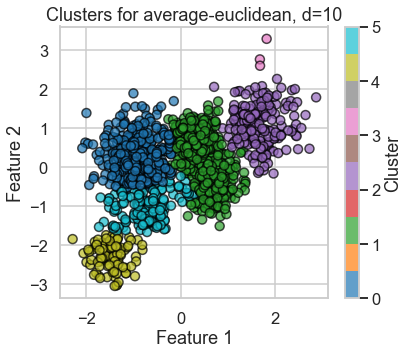

Silhouette Score for affinity=euclidean, linkage=average, distance_threshold=10: 0.41905992435661027, n_clusters=5


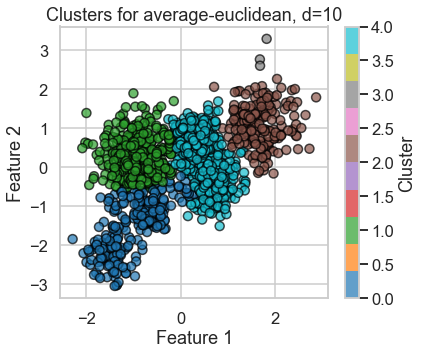

Silhouette Score for affinity=euclidean, linkage=average, distance_threshold=10: 0.41905992435661027, n_clusters=5


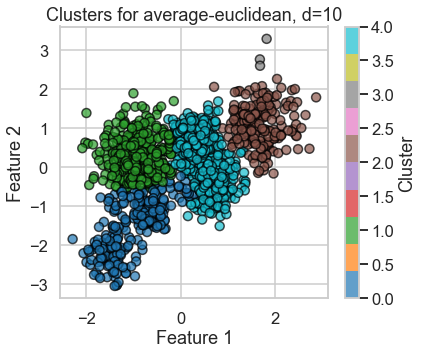

Silhouette Score for affinity=euclidean, linkage=average, distance_threshold=10: 0.34468938227555507, n_clusters=4


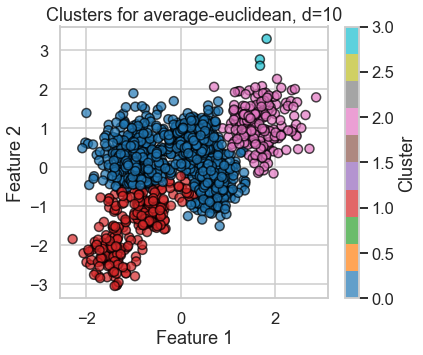

Silhouette Score for affinity=euclidean, linkage=average, distance_threshold=10: 0.3622226549861079, n_clusters=3


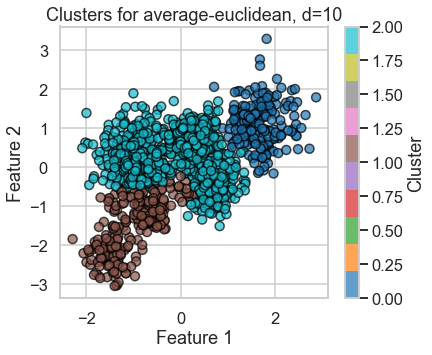

Silhouette Score for affinity=cosine, linkage=average, distance_threshold=10: 0.423606851876823, n_clusters=2


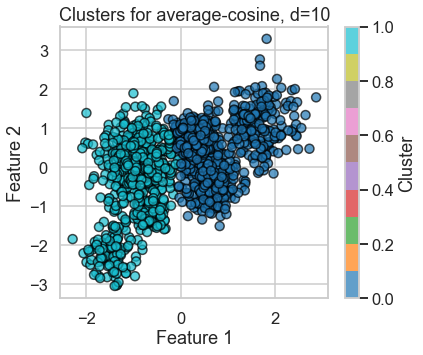

Silhouette Score for affinity=cosine, linkage=average, distance_threshold=10: 0.423606851876823, n_clusters=2


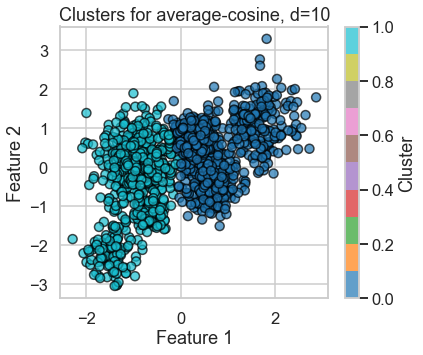

Silhouette Score for affinity=manhattan, linkage=average, distance_threshold=10: 0.4101176224696422, n_clusters=8


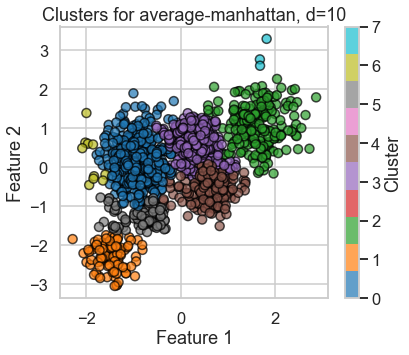

Silhouette Score for affinity=manhattan, linkage=average, distance_threshold=10: 0.4101176224696422, n_clusters=8


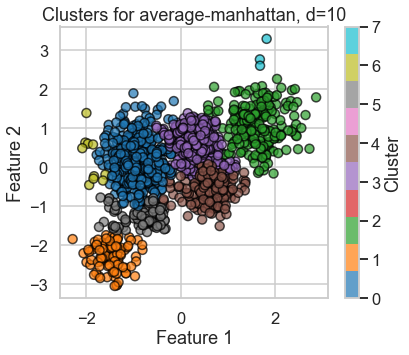

Silhouette Score for affinity=manhattan, linkage=average, distance_threshold=10: 0.35917752472185926, n_clusters=7


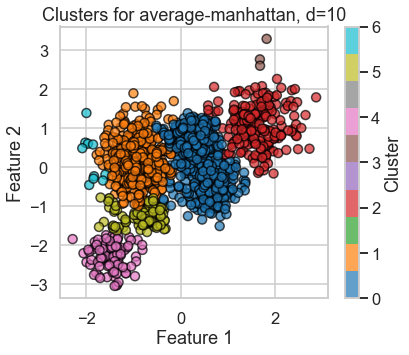

Silhouette Score for affinity=manhattan, linkage=average, distance_threshold=10: 0.39302609188941084, n_clusters=6


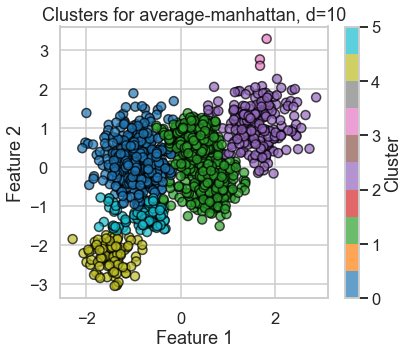

Silhouette Score for affinity=manhattan, linkage=average, distance_threshold=10: 0.41206890339331737, n_clusters=5


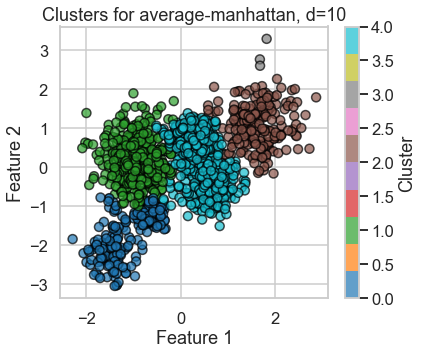

Silhouette Score for affinity=euclidean, linkage=complete, distance_threshold=10: 0.3083571719723685, n_clusters=22


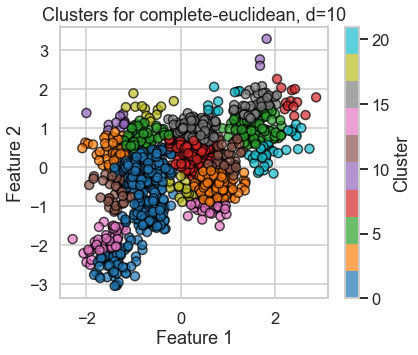

Silhouette Score for affinity=euclidean, linkage=complete, distance_threshold=10: 0.30897182603368734, n_clusters=20


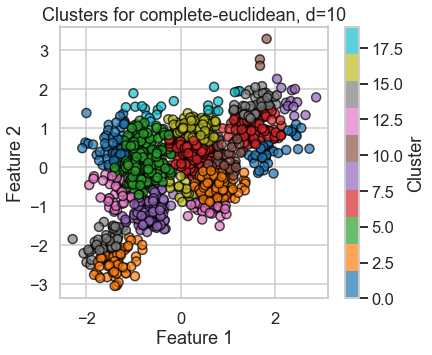

Silhouette Score for affinity=euclidean, linkage=complete, distance_threshold=10: 0.32798165613597313, n_clusters=17


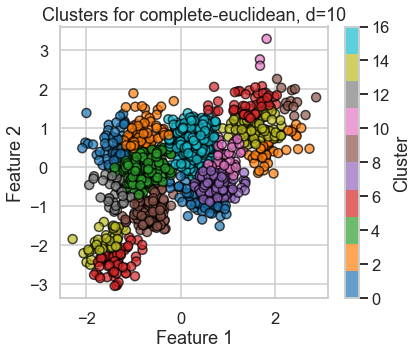

Silhouette Score for affinity=euclidean, linkage=complete, distance_threshold=10: 0.34990714034886966, n_clusters=15


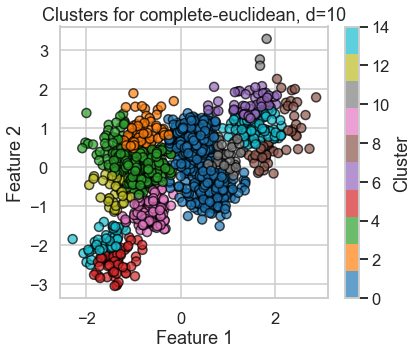

Silhouette Score for affinity=euclidean, linkage=complete, distance_threshold=10: 0.39493608021759763, n_clusters=11


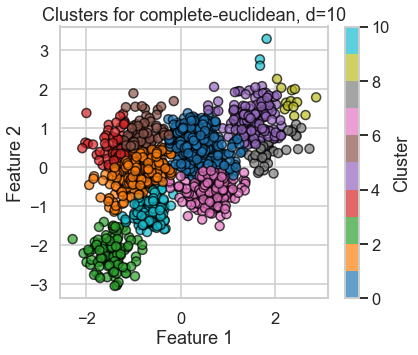

Silhouette Score for affinity=cosine, linkage=complete, distance_threshold=10: 0.2489393544690291, n_clusters=5


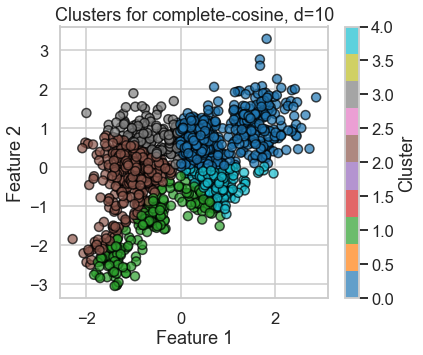

Silhouette Score for affinity=cosine, linkage=complete, distance_threshold=10: 0.2489393544690291, n_clusters=5


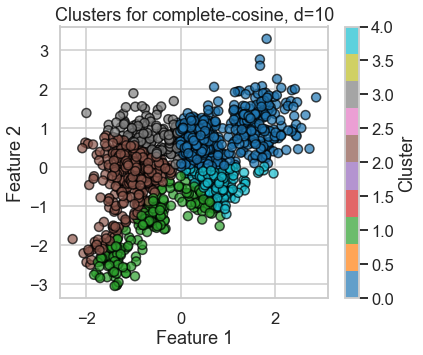

Silhouette Score for affinity=cosine, linkage=complete, distance_threshold=10: 0.2489393544690291, n_clusters=5


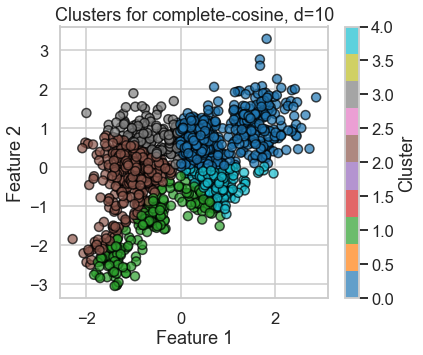

Silhouette Score for affinity=cosine, linkage=complete, distance_threshold=10: 0.24193296738456982, n_clusters=4


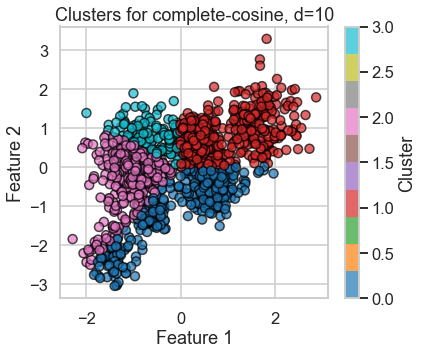

Silhouette Score for affinity=manhattan, linkage=complete, distance_threshold=10: 0.2984056907037037, n_clusters=36


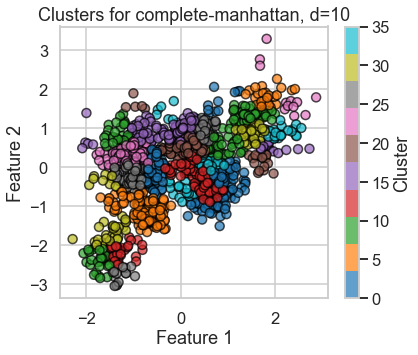

Silhouette Score for affinity=manhattan, linkage=complete, distance_threshold=10: 0.2719608216927779, n_clusters=30


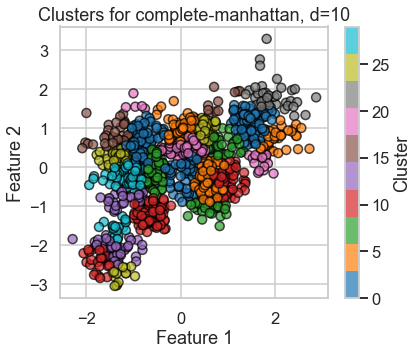

Silhouette Score for affinity=manhattan, linkage=complete, distance_threshold=10: 0.2719608216927779, n_clusters=30


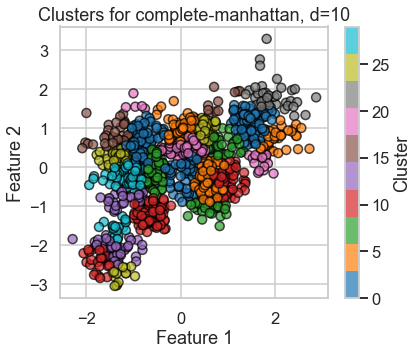

Silhouette Score for affinity=manhattan, linkage=complete, distance_threshold=10: 0.27904178693723536, n_clusters=28


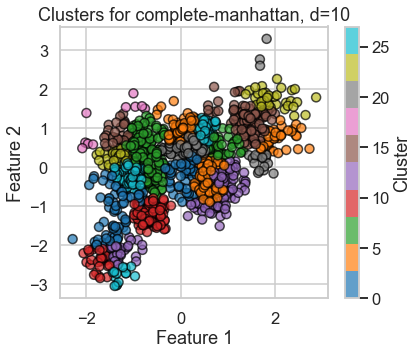

Silhouette Score for affinity=manhattan, linkage=complete, distance_threshold=10: 0.27880184246411144, n_clusters=20


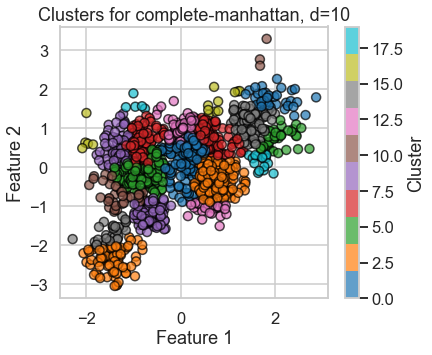

Silhouette Score for affinity=euclidean, linkage=ward, distance_threshold=10: 0.31248880784267286, n_clusters=56


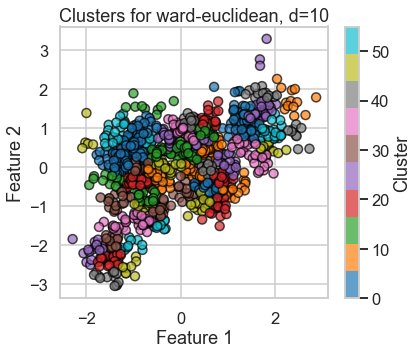

Silhouette Score for affinity=euclidean, linkage=ward, distance_threshold=10: 0.30817619554312514, n_clusters=53


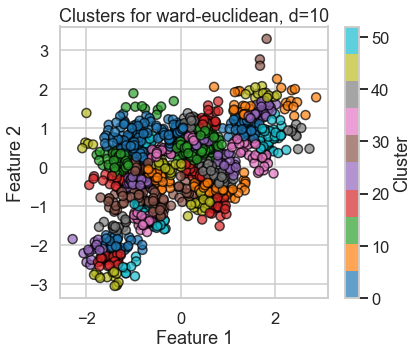

Silhouette Score for affinity=euclidean, linkage=ward, distance_threshold=10: 0.30265067058273637, n_clusters=48


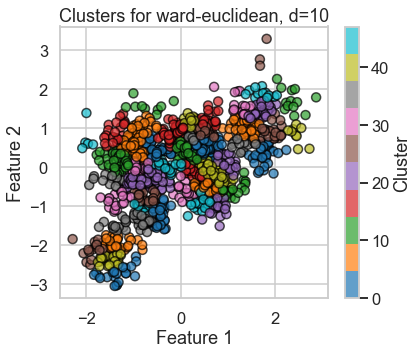

Silhouette Score for affinity=euclidean, linkage=ward, distance_threshold=10: 0.303370487349193, n_clusters=47


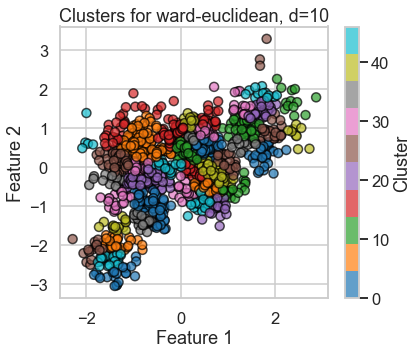

Silhouette Score for affinity=euclidean, linkage=ward, distance_threshold=10: 0.2932048099558007, n_clusters=37


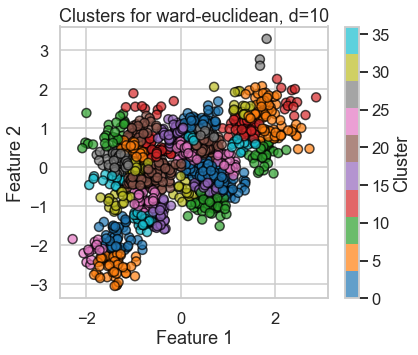

Silhouette Score for affinity=euclidean, linkage=ward, distance_threshold=10: 0.4548664117944667, n_clusters=7


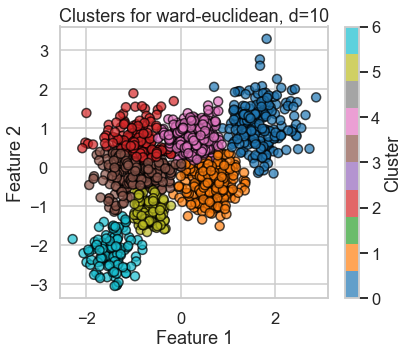

Silhouette Score for affinity=euclidean, linkage=ward, distance_threshold=10: 0.46941860470586316, n_clusters=5


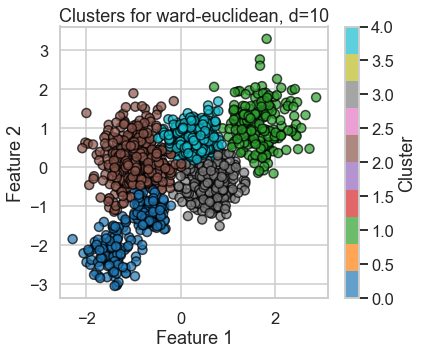


Best Agglomerative Clustering configuration:
{'linkage': 'average', 'affinity': 'euclidean', 'threshold': 1.4, 'n_clusters': 6, 'silhouette': 0.27880184246411144}


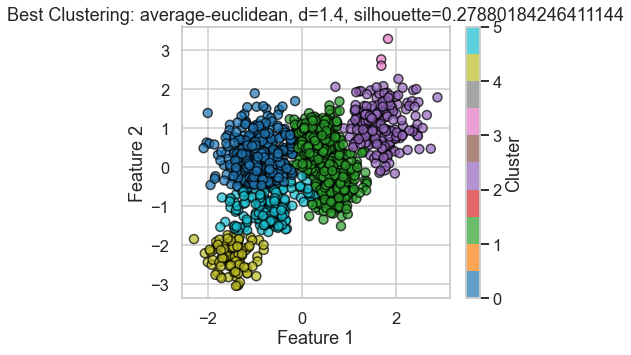

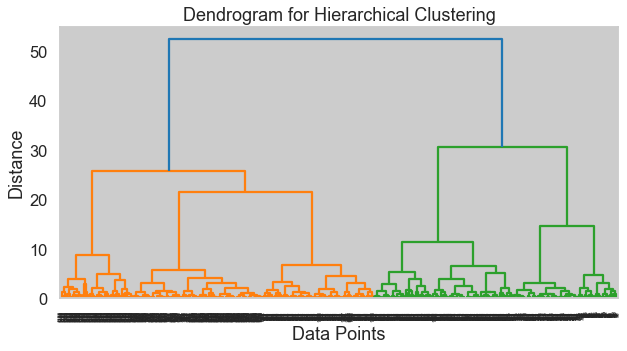

In [55]:
linkage_list = ["average", "single", "complete", "ward"]
affinity_list = ["euclidean", "cosine", "manhattan"]
dist_thresholds = [1.4, 1.5, 1.6, 1.65, 2.0, 10, 20]  # Thresholds for scaled data

best_score = -1
best_params = {}

for linkage in linkage_list:
    for affinity in affinity_list:
        if linkage == 'ward' and affinity != 'euclidean':
            continue
            
        for d in dist_thresholds:
            model = AgglomerativeClustering(
                n_clusters=None,
                distance_threshold=d,
                linkage=linkage,
                affinity=affinity
            )
            
            labels = model.fit_predict(scaled_df)
            n_clusters = len(np.unique(labels))
            
            if n_clusters > 1:
                silhouette = silhouette_score(scaled_df, labels)
                print(f"Silhouette Score for affinity={affinity}, linkage={linkage}, distance_threshold={distance_threshold}: {silhouette}, n_clusters={n_clusters}")
                
                if score > best_score:
                    best_score = score
                    best_params = {
                        'linkage': linkage,
                        'affinity': affinity,
                        'threshold': d,
                        'n_clusters': n_clusters,
                        'silhouette': best_score
                    }
            
            # Plot clustered data
                plt.figure(figsize=(6, 5))
                plt.scatter(scaled_df[:, 0], scaled_df[:, 1], c=labels, cmap='tab10', edgecolors='k', alpha=0.7)
                plt.title(f"Clusters for {linkage}-{affinity}, d={distance_threshold}")
                plt.xlabel("Feature 1")
                plt.ylabel("Feature 2")
                plt.colorbar(label="Cluster")
                plt.show()

                
print("\nBest Agglomerative Clustering configuration:")
print(best_params)

best_model = AgglomerativeClustering(
    n_clusters=None,
    distance_threshold=best_params['threshold'],
    linkage=best_params['linkage'],
    affinity=best_params['affinity']
)
best_labels = best_model.fit_predict(scaled_df)

# 7. Visualize Best Clustering
plt.figure(figsize=(6, 5))
plt.scatter(scaled_df[:, 0], scaled_df[:, 1], c=best_labels, cmap='tab10', edgecolors='k', alpha=0.7)
plt.title(f"Best Clustering: {best_params['linkage']}-{best_params['affinity']}, d={best_params['threshold']}, silhouette={best_params['silhouette']}")
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.colorbar(label="Cluster")
plt.show()
#display_scaled_cluster(scaled_df, best_labels.labels_)
#plt.title(f"Best Clustering Result\nSilhouette Score: {best_score:.3f}")
#plt.show()

plt.figure(figsize=(10, 5))
linked = sch.linkage(scaled_df, method="ward")  # Use "ward" for a clear dendrogram
sch.dendrogram(linked)
plt.title("Dendrogram for Hierarchical Clustering")
plt.xlabel("Data Points")
plt.ylabel("Distance")
plt.show()

In [ ]:
# The distance threshold was tested from [1, 1.1, 1.3, 1.5, 2, 5, 10, 20]
# The small thresholds caused the model to create a lot of clusters > 100 so the range was adjusted till it reached this final form
# The best model gave the expected 6 clusters however there is a very small cluster compared to the others
# The best model's parameters were euclidean affinity, average linkage with a 1.4 distance thershold

### DBScan
* Use DBScan function to  to cluster the above data. 
* In the  DBscan change the following parameters: 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
    * Another option: Lookup K-Distance graph method
* Plot the silhouette_score versus the variation in the EPS and the min_samples.
* Plot the resulting Clusters in this case. 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments. 

In [70]:
!pip install kneed

In [71]:
from sklearn.cluster import DBSCAN

In [296]:
eps_values = np.arange(0.1, 6.1, 0.1)
min_samples_values = np.arange(5, 30, 5)

output = []
best_score = -1
best_params = None

eps: 0.10, min_samples: 5, Clusters: 26, Silhouette Score: -0.2507
eps: 0.10, min_samples: 10, Clusters: 8, Silhouette Score: -0.2083
eps: 0.10, min_samples: 15, Clusters: 7, Silhouette Score: -0.2652
eps: 0.10, min_samples: 20, Clusters: 2, Silhouette Score: -0.1913
eps: 0.10, min_samples: 25, Clusters: 2, Silhouette Score: -0.3042
eps: 0.20, min_samples: 5, Clusters: 2, Silhouette Score: 0.2358
eps: 0.20, min_samples: 10, Clusters: 3, Silhouette Score: 0.2017
eps: 0.20, min_samples: 15, Clusters: 6, Silhouette Score: 0.0893
eps: 0.20, min_samples: 20, Clusters: 3, Silhouette Score: 0.1920
eps: 0.20, min_samples: 25, Clusters: 3, Silhouette Score: 0.1497
eps: 0.30, min_samples: 20, Clusters: 3, Silhouette Score: 0.2389
eps: 0.30, min_samples: 25, Clusters: 3, Silhouette Score: 0.2124


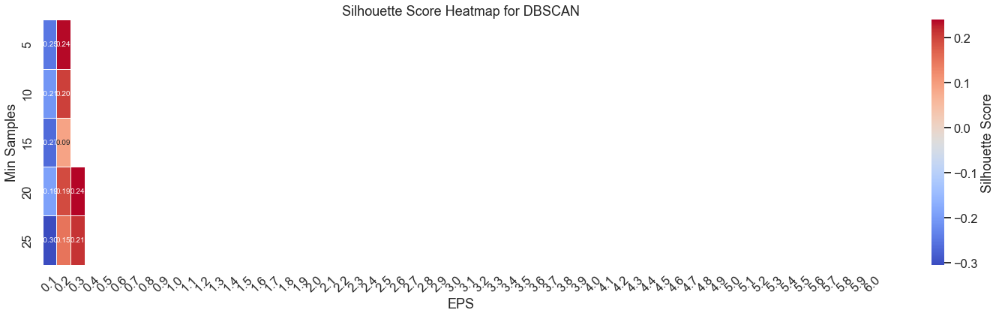


Best Parameters:
EPS: 0.300, Min Samples: 20, Clusters: 3
Best Silhouette Score: 0.2389


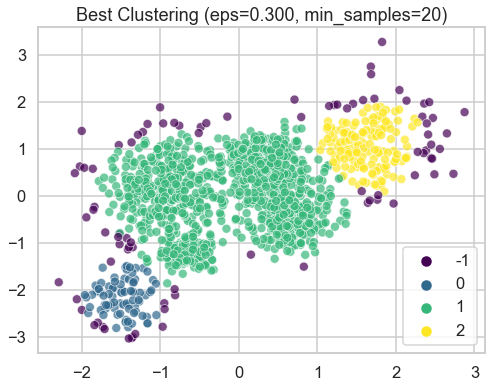

In [297]:
for eps in eps_values:
    for min_samples in min_samples_values:
        model = DBSCAN(eps=eps, min_samples=min_samples)
        labels = model.fit_predict(scaled_df)
        n_clusters = len(set(labels) - {-1})

        if n_clusters > 1:
            silhouette = silhouette_score(scaled_df, labels)
            output.append((eps, min_samples, silhouette, n_clusters))

            # Update best score
            if silhouette > best_score:
                best_score = silhouette
                best_params = (eps, min_samples, n_clusters)

            # Print each iteration's results
            print(f"eps: {eps:.2f}, min_samples: {min_samples}, Clusters: {n_clusters}, Silhouette Score: {silhouette:.4f}")

output = np.array(output, dtype=object)

data = np.full((len(min_samples_values), len(eps_values)), np.nan)

for i, min_samples in enumerate(min_samples_values):
    for j, eps in enumerate(eps_values):
        match = output[(output[:, 0] == eps) & (output[:, 1] == min_samples)]
        if len(match) > 0:
            data[i, j] = match[0, 2]
            
plt.figure(figsize=(25, 6))
ax = sns.heatmap(data, xticklabels=np.round(eps_values, 3),
                 yticklabels=min_samples_values, cmap="coolwarm", annot=True,
                 fmt=".2f", linewidths=0.5, cbar_kws={'label': 'Silhouette Score'})

plt.xlabel("EPS")
plt.ylabel("Min Samples")
plt.xticks(rotation=45)
plt.title("Silhouette Score Heatmap for DBSCAN")
plt.show()

print("\nBest Parameters:")
print(f"EPS: {best_params[0]:.3f}, Min Samples: {best_params[1]}, Clusters: {best_params[2]}")
print(f"Best Silhouette Score: {best_score:.4f}")

best_eps, best_min_samples, _ = best_params
best_model = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_model.fit_predict(scaled_df)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=scaled_df[:, 0], y=scaled_df[:, 1], hue=best_labels, palette='viridis', alpha=0.7)
plt.title(f"Best Clustering (eps={best_eps:.3f}, min_samples={best_min_samples})")
plt.legend()
plt.show()

In [ ]:
# The DBScan algorithm resulted in less clusters than expected (3 instead of 6)
# The eps range was expanded from the suggested 0.1-3.0 to 0.1 to 6.0 however values after 3 ...
# result in 0 clusters which is not valid in our case
# This may be because the data is too tight for DBScan to correctly isolate clusters from each other
# Trials done showed the best parameters to be eps = 0.3 and min_samples of 20

In [ ]:
# K-means gave the best silhouette score of 0.4862522276594507
# this may be due to the fact that the clusters are roughly circular

## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers. 

The data represents three classes. 


In [152]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']

['setosa', 'versicolor', 'virginica']

In [158]:
iris_df = pd.DataFrame(iris_data.data, columns=iris_data.feature_names)
iris_df['target'] = iris_data.target
iris_df['species'] = pd.Categorical.from_codes(iris_data.target, iris_data.target_names)
iris_df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target,species
0,5.1,3.5,1.4,0.2,0,setosa
1,4.9,3.0,1.4,0.2,0,setosa
2,4.7,3.2,1.3,0.2,0,setosa
3,4.6,3.1,1.5,0.2,0,setosa
4,5.0,3.6,1.4,0.2,0,setosa


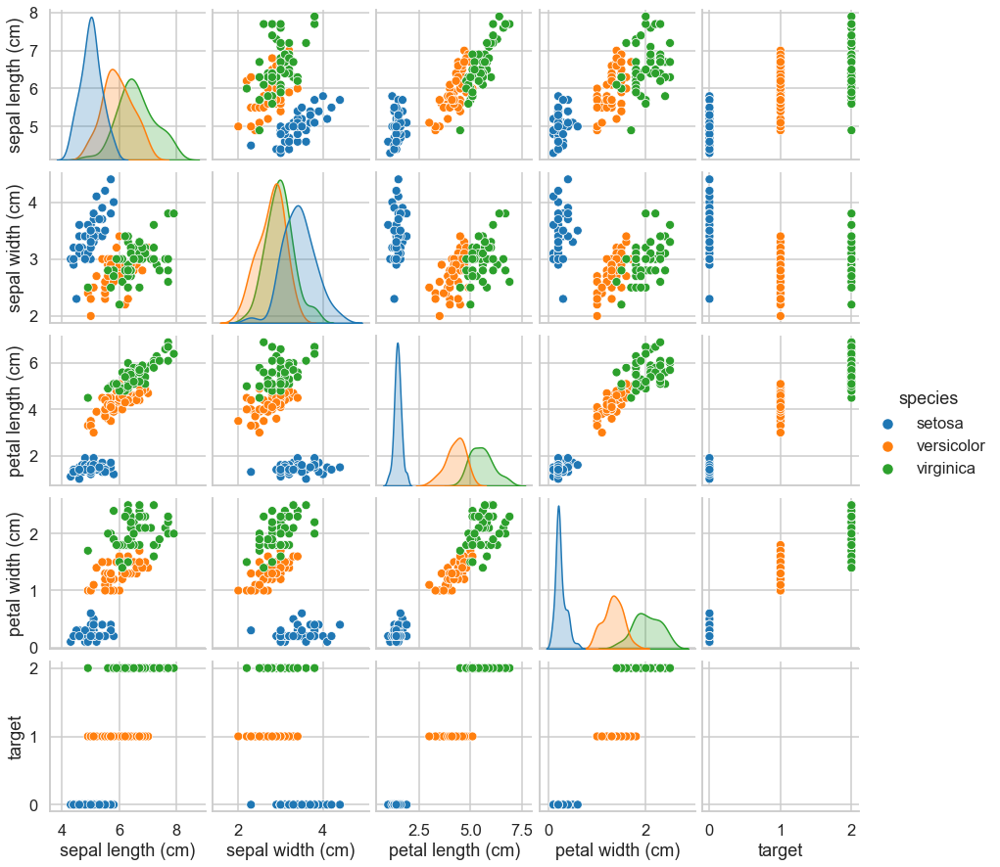

In [217]:
sns.pairplot(iris_df, hue='species')
plt.show()

* Repeat all the above clustering approaches and steps on the above data. 
* Comment on the effect of scaling on clustering this dataset. Show the difference between clustering the data with and without   scaling.
* Compare between the different clustering approaches. 
* Is your clustering outcome consistent with the labels?

## K-Means without scaling

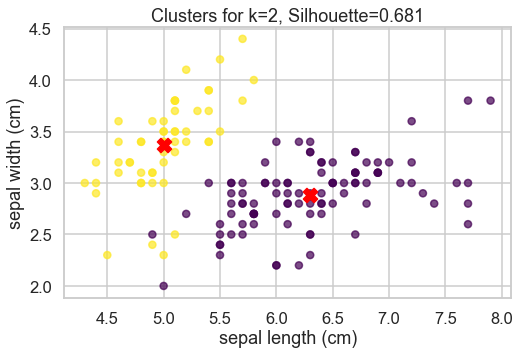

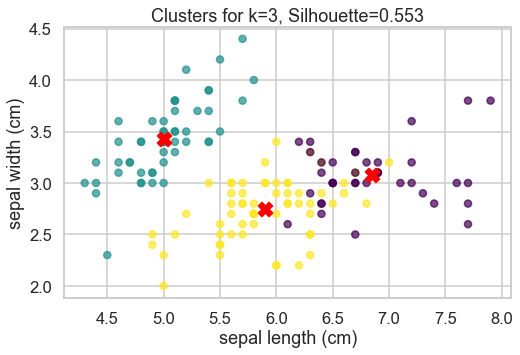

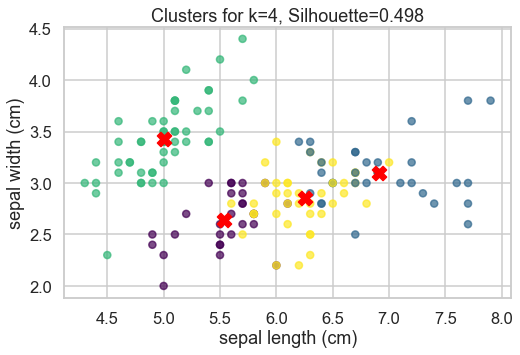

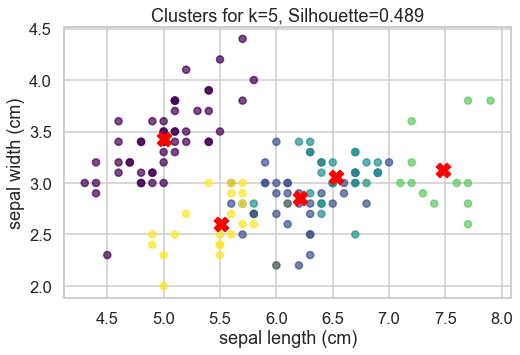

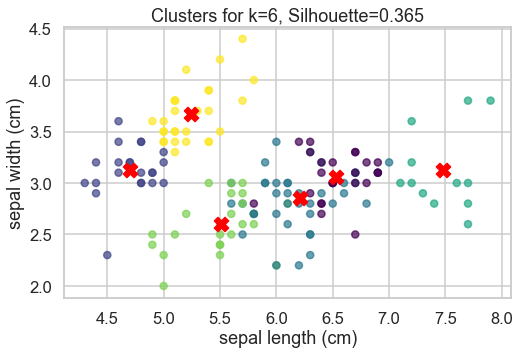

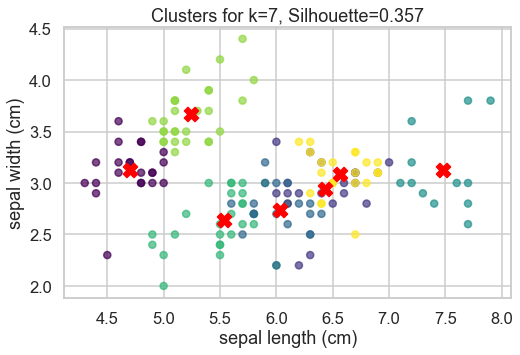

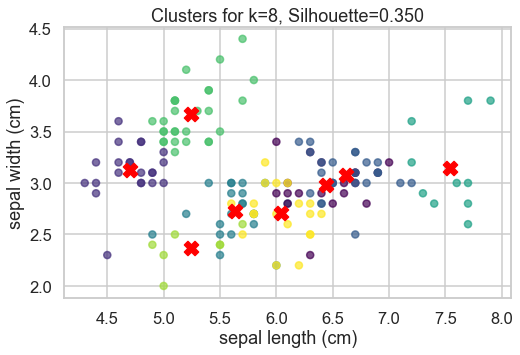

Best number of clusters based on silhouette score: 2


In [299]:
X = iris_df[iris_data.feature_names]

ssd = []      # to track the inertia (SSD)
sil_scores = []  # to track the silhouette scores
best = -1
best_n = 1

# Loop over the desired range of clusters
for k in range(2, 9):
    model = KMeans(n_clusters=k)
    model.fit(X)
    
    # Compute silhouette score using the same features
    silhouette = silhouette_score(X, model.labels_)
    sil_scores.append(silhouette)
    
    if silhouette >= best:
        best_n = k
        best = silhouette

    # Plot the clustering result using the first two features for visualization
    plt.figure(figsize=(8, 5))
    plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=model.labels_, cmap='viridis', s=50, alpha=0.7)
    centers = model.cluster_centers_
    plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, marker='X')
    plt.title(f'Clusters for k={k}, Silhouette={silhouette:.3f}')
    plt.xlabel(iris_data.feature_names[0])
    plt.ylabel(iris_data.feature_names[1])
    plt.show()
    
    # Save the inertia (SSD) for this model
    ssd.append(model.inertia_)

print("Best number of clusters based on silhouette score:", best_n)

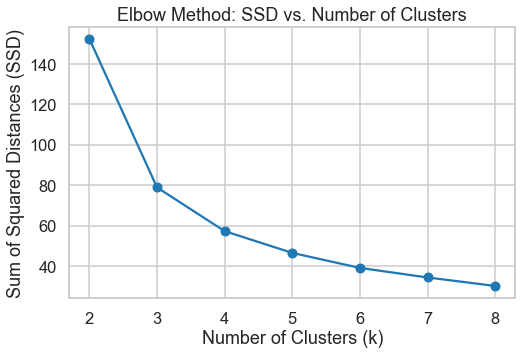

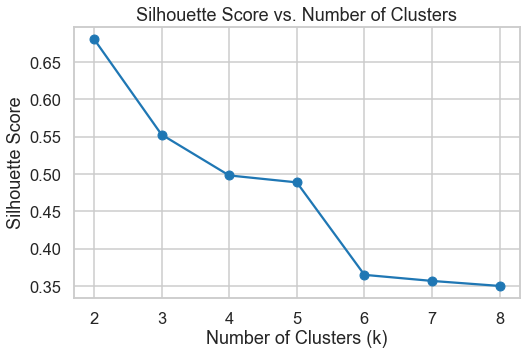

In [300]:
# Plot SSD vs. Number of Clusters (Elbow Plot)
plt.figure(figsize=(8, 5))
plt.plot(np.arange(2,9), ssd, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Sum of Squared Distances (SSD)")
plt.title("Elbow Method: SSD vs. Number of Clusters")
plt.show()

# Plot Silhouette Score vs. Number of Clusters
plt.figure(figsize=(8, 5))
plt.plot(np.arange(2,9), sil_scores, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score vs. Number of Clusters")
plt.show()

In [301]:
print(best)

0.6810461692117462


In [ ]:
# K-means showed that 2 clusters is the best division of the data set
# This is not consistent with the real dataset that contains three different species
# This may be due to the fact that 2 species are very close to each other (Versicolor and Virginica)
# Since the algorithm bases it correctness of how close the points are to each other it may ...
# consider that these 2 species should be clustered into 1 cluster instead of 2

## K-Means with scaling

In [171]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

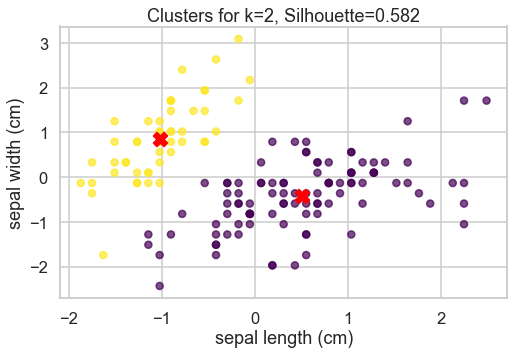

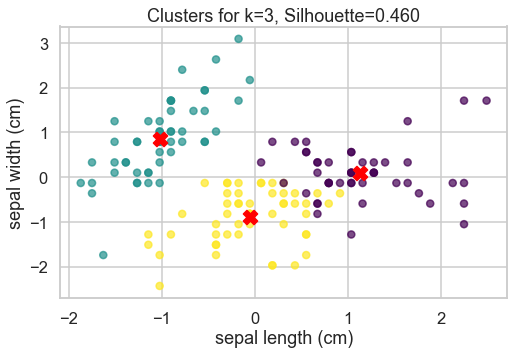

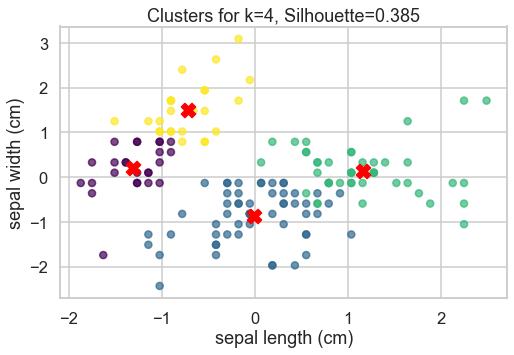

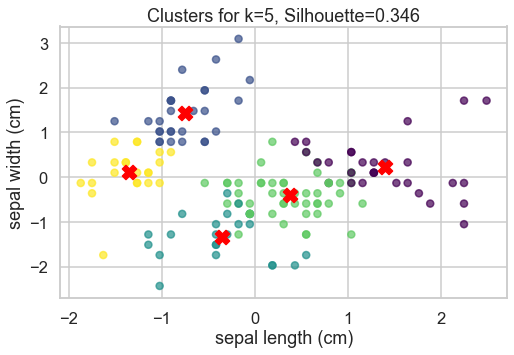

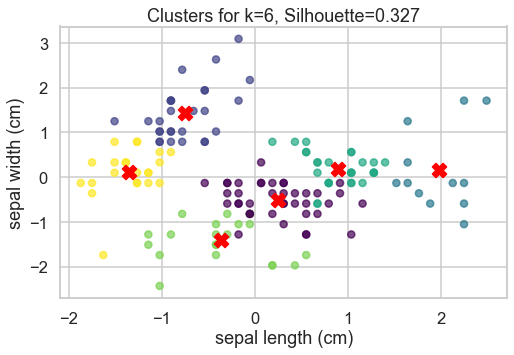

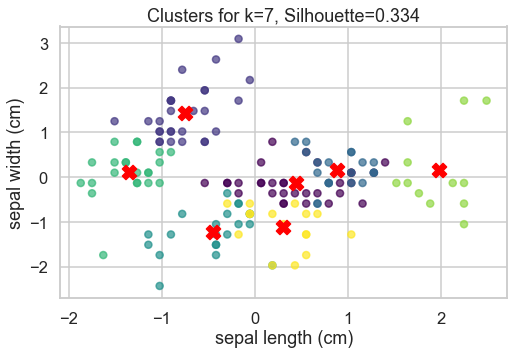

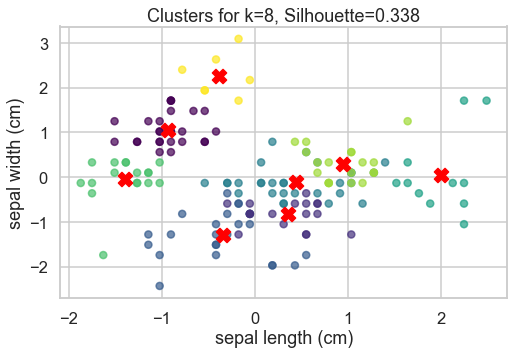

Best number of clusters based on silhouette score: 2


In [302]:
ssd = []      # to track the inertia (SSD)
sil_scores = []  # to track the silhouette scores
best = -1
best_n = 1

# Loop over the desired range of clusters
for k in range(2, 9):
    model = KMeans(n_clusters=k)
    model.fit(X_scaled)
    
    # Compute silhouette score using the same features
    silhouette = silhouette_score(X_scaled, model.labels_)
    sil_scores.append(silhouette)
    
    if silhouette >= best:
        best_n = k
        best = silhouette

    # Plot the clustering result using the first two features for visualization
    plt.figure(figsize=(8, 5))
    plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=model.labels_, cmap='viridis', s=50, alpha=0.7)
    centers = model.cluster_centers_
    plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, marker='X')
    plt.title(f'Clusters for k={k}, Silhouette={silhouette:.3f}')
    plt.xlabel(iris_data.feature_names[0])
    plt.ylabel(iris_data.feature_names[1])
    plt.show()
    
    # Save the inertia (SSD) for this model
    ssd.append(model.inertia_)

print("Best number of clusters based on silhouette score:", best_n)

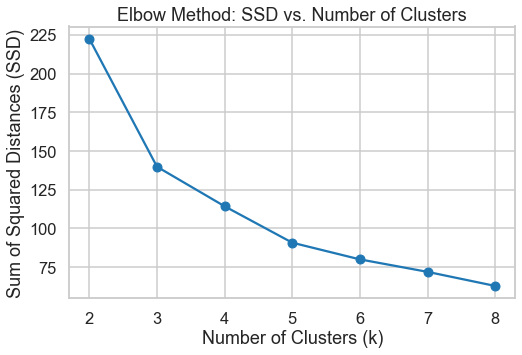

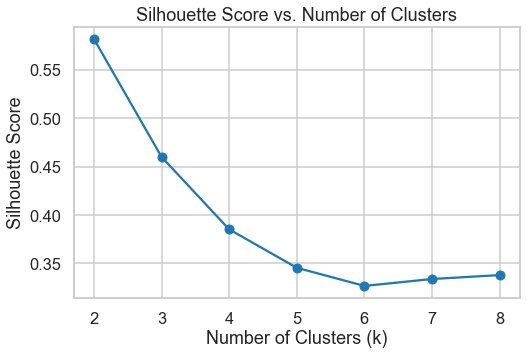

In [303]:
# Plot SSD vs. Number of Clusters (Elbow Plot)
plt.figure(figsize=(8, 5))
plt.plot(np.arange(2,9), ssd, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Sum of Squared Distances (SSD)")
plt.title("Elbow Method: SSD vs. Number of Clusters")
plt.show()

# Plot Silhouette Score vs. Number of Clusters
plt.figure(figsize=(8, 5))
plt.plot(np.arange(2,9), sil_scores, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score vs. Number of Clusters")
plt.show()

In [304]:
print(best)

0.5817500491982808


In [ ]:
# Scaling did not give better results as 2 clusters still gave the best silhouette

## Agglomerative clustering without scaling

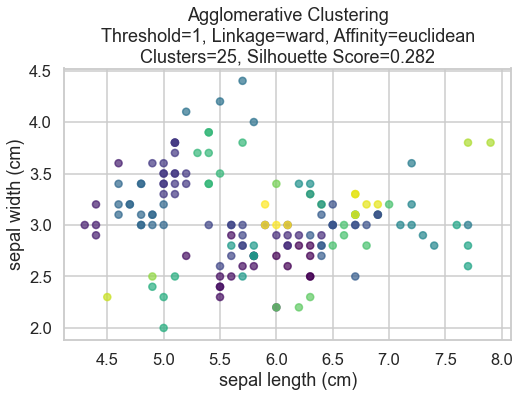

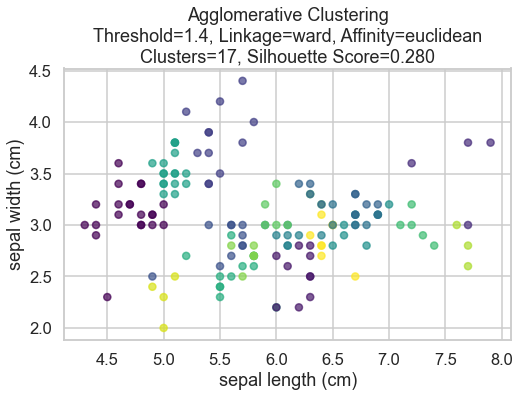

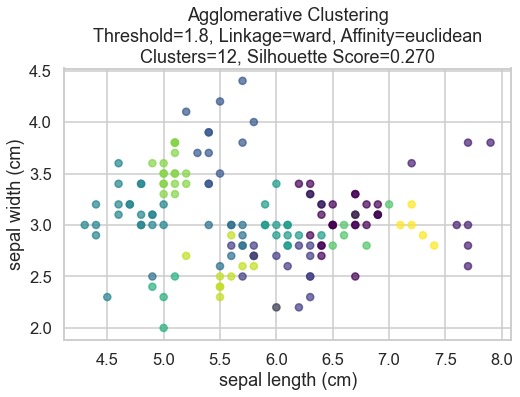

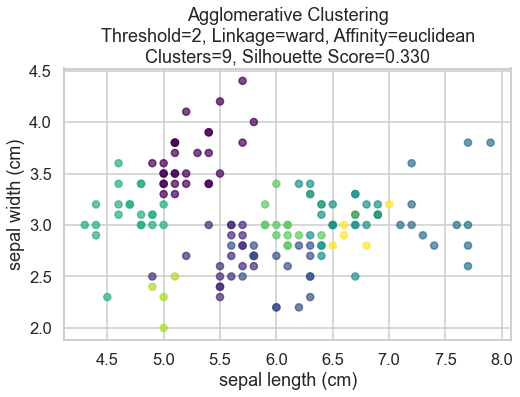

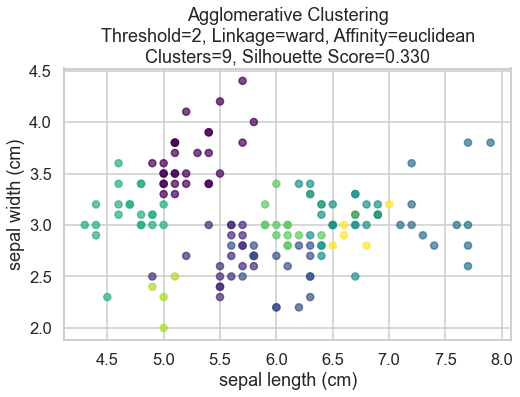

...

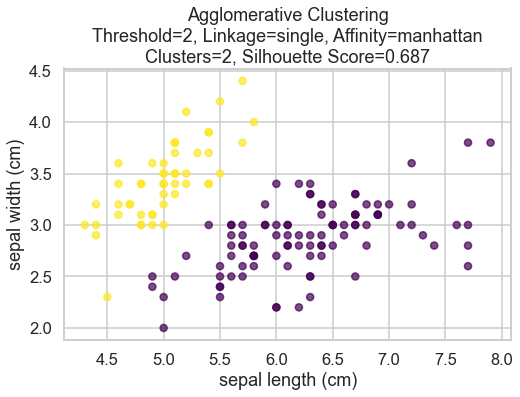

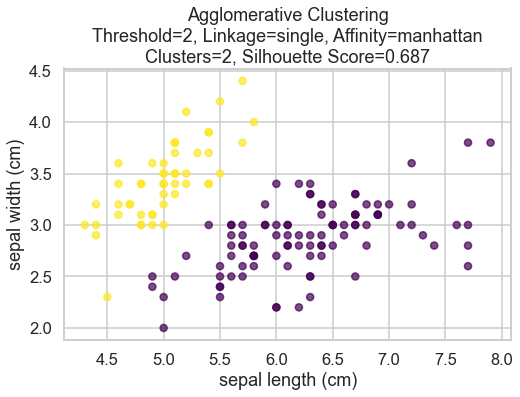

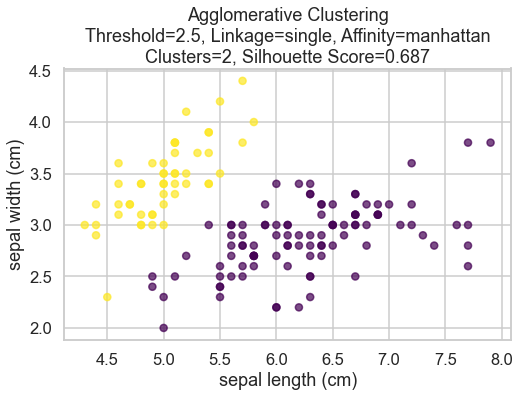

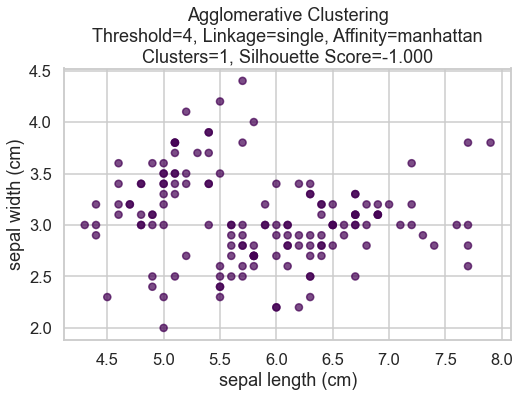

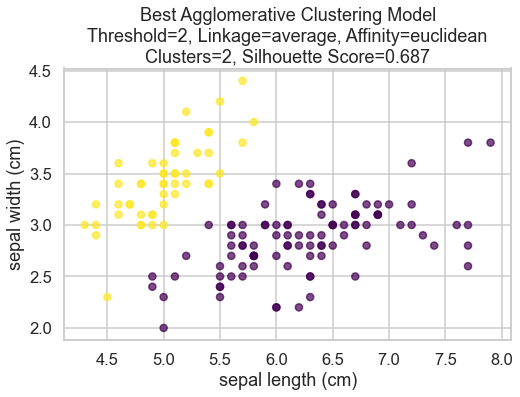

In [314]:
X = iris_df[iris_data.feature_names]

# Define parameters to vary
thresholds = [1, 1.4, 1.8, 2, 2,2, 2.5, 4]  # Distance thresholds to try
linkages = ['ward', 'complete', 'average', 'single']
affinities = ['euclidean', 'manhattan']

# Variables to track the best combination
best_sil = -1
best_threshold = None
best_linkage = None
best_affinity = None

# Loop over each combination of linkage and affinity
for linkage in linkages:
    for affinity in affinities:
        # For ward linkage, affinity must be euclidean
        if linkage == 'ward' and affinity != 'euclidean':
            continue

        sil_scores_list = []  # To track silhouette scores for each threshold for this combination

        # Loop over the defined distance thresholds
        for thresh in thresholds:
            # Set up AgglomerativeClustering with the current parameters.
            # When distance_threshold is set, n_clusters must be None.
            model = AgglomerativeClustering(distance_threshold=thresh, n_clusters=None,
                                            linkage=linkage, affinity=affinity)
            model.fit(X)
            labels = model.labels_
            n_clusters = np.unique(labels).size

            # Compute silhouette score only if more than one cluster is formed
            if n_clusters > 1:
                sil = silhouette_score(X, labels)
            else:
                sil = -1
            sil_scores_list.append(sil)

            # Update best parameters if the current silhouette score is the best so far
            if sil > best_sil:
                best_sil = sil
                best_threshold = thresh
                best_linkage = linkage
                best_affinity = affinity

            # Plot the clustering result using the first two features for visualization
            plt.figure(figsize=(8, 5))
            plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=labels, cmap='viridis', s=50, alpha=0.7)
            plt.title(f'Agglomerative Clustering\n'
                      f'Threshold={thresh}, Linkage={linkage}, Affinity={affinity}\n'
                      f'Clusters={n_clusters}, Silhouette Score={sil:.3f}')
            plt.xlabel(iris_data.feature_names[0])
            plt.ylabel(iris_data.feature_names[1])
            plt.show()
        
best_model = AgglomerativeClustering(distance_threshold=best_threshold, n_clusters=None,
                                     linkage=best_linkage, affinity=best_affinity)
best_model.fit(X)
best_labels = best_model.labels_
n_clusters_best = np.unique(best_labels).size

plt.figure(figsize=(8, 5))
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=best_labels, cmap='viridis', s=50, alpha=0.7)
plt.title(f'Best Agglomerative Clustering Model\n'
          f'Threshold={best_threshold}, Linkage={best_linkage}, Affinity={best_affinity}\n'
          f'Clusters={n_clusters_best}, Silhouette Score={best_sil:.3f}')
plt.xlabel(iris_data.feature_names[0])
plt.ylabel(iris_data.feature_names[1])
plt.show()

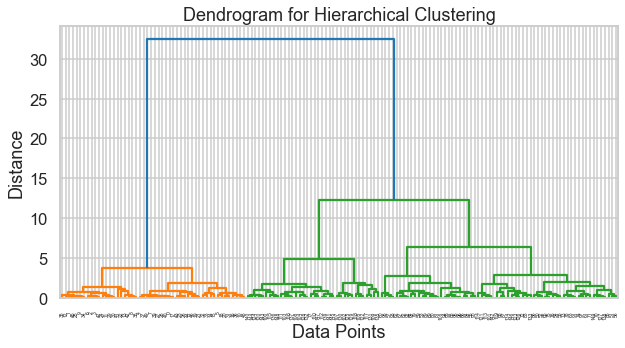

0.6867350732769777


In [315]:
plt.figure(figsize=(10, 5))
linked = sch.linkage(X, method="ward")  # Use "ward" for a clear dendrogram
sch.dendrogram(linked)
plt.title("Dendrogram for Hierarchical Clustering")
plt.xlabel("Data Points")
plt.ylabel("Distance")
plt.show()
print(best_sil)

In [ ]:
# Agglomerative clustering did not solve the problem of the 2 species being considered one ...
# because of the closeness to each other
# A wide range of threshold distances was used in order to avoid this problem however the ...
# algorithm still could not differentiate between Versicolor and Virginica

## Agglomerative clustering with scaling

In [ ]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

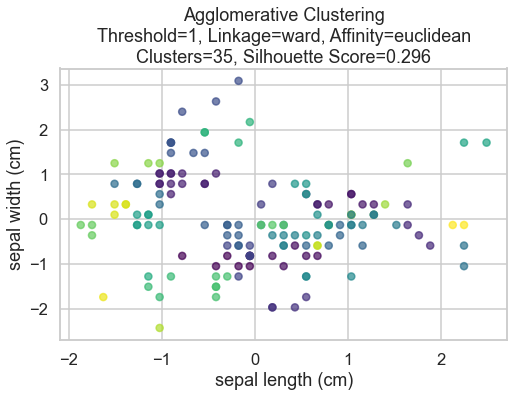

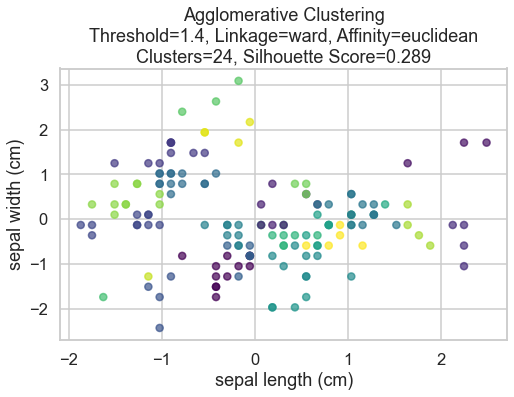

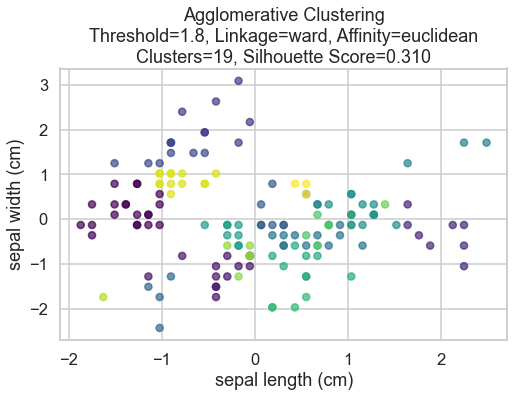

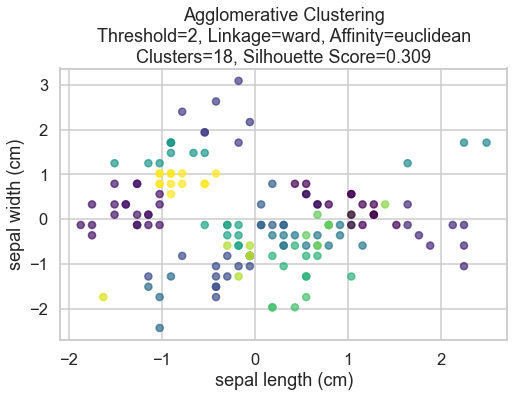

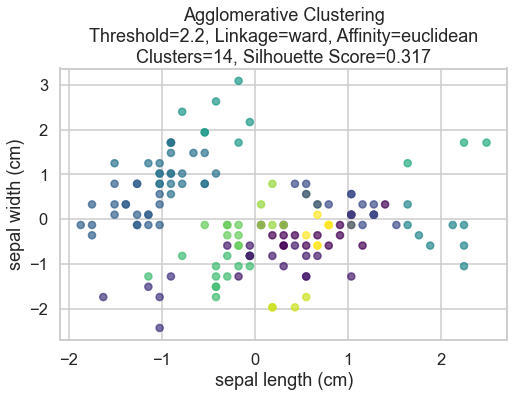

...

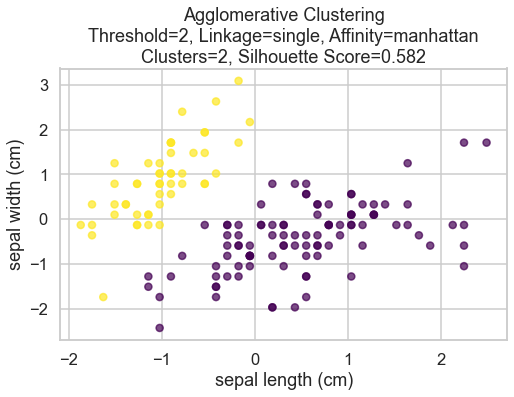

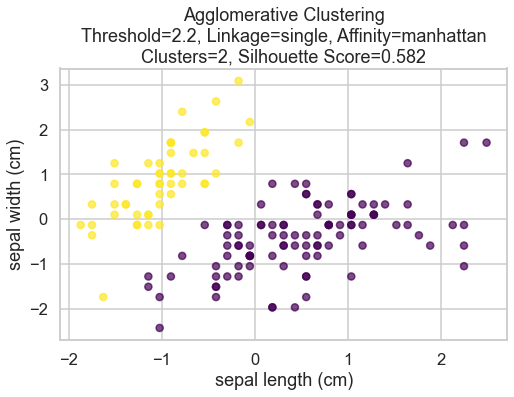

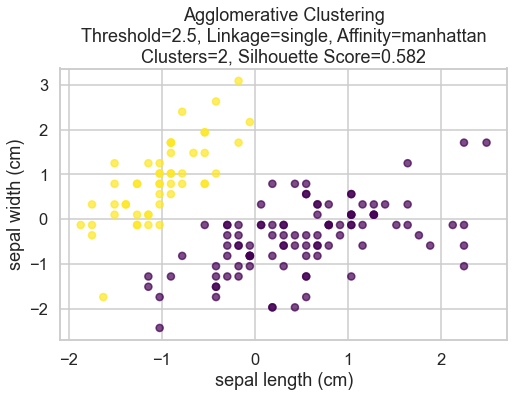

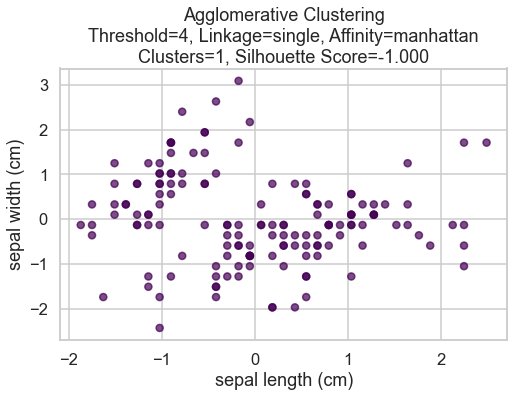

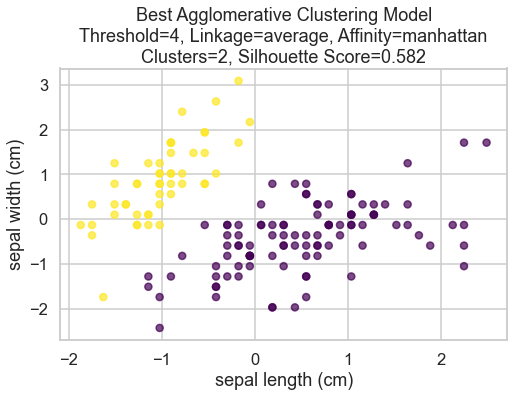

In [316]:
X = iris_df[iris_data.feature_names]

# Define parameters to vary
thresholds = [1, 1.4, 1.8, 2, 2.2, 2.5, 4]  # Distance thresholds to try
linkages = ['ward', 'complete', 'average', 'single']
affinities = ['euclidean', 'manhattan']

# Variables to track the best combination
best_sil = -1
best_threshold = None
best_linkage = None
best_affinity = None

# Loop over each combination of linkage and affinity
for linkage in linkages:
    for affinity in affinities:
        # For ward linkage, affinity must be euclidean
        if linkage == 'ward' and affinity != 'euclidean':
            continue

        sil_scores_list = []  # To track silhouette scores for each threshold for this combination

        # Loop over the defined distance thresholds
        for thresh in thresholds:
            # Set up AgglomerativeClustering with the current parameters.
            # When distance_threshold is set, n_clusters must be None.
            model = AgglomerativeClustering(distance_threshold=thresh, n_clusters=None,
                                            linkage=linkage, affinity=affinity)
            model.fit(X_scaled)
            labels = model.labels_
            n_clusters = np.unique(labels).size

            # Compute silhouette score only if more than one cluster is formed
            if n_clusters > 1:
                sil = silhouette_score(X_scaled, labels)
            else:
                sil = -1
            sil_scores_list.append(sil)

            # Update best parameters if the current silhouette score is the best so far
            if sil > best_sil:
                best_sil = sil
                best_threshold = thresh
                best_linkage = linkage
                best_affinity = affinity

            # Plot the clustering result using the first two features for visualization
            plt.figure(figsize=(8, 5))
            plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=labels, cmap='viridis', s=50, alpha=0.7)
            plt.title(f'Agglomerative Clustering\n'
                      f'Threshold={thresh}, Linkage={linkage}, Affinity={affinity}\n'
                      f'Clusters={n_clusters}, Silhouette Score={sil:.3f}')
            plt.xlabel(iris_data.feature_names[0])
            plt.ylabel(iris_data.feature_names[1])
            plt.show()
        
best_model = AgglomerativeClustering(distance_threshold=best_threshold, n_clusters=None,
                                     linkage=best_linkage, affinity=best_affinity)
best_model.fit(X_scaled)
best_labels = best_model.labels_
n_clusters_best = np.unique(best_labels).size

plt.figure(figsize=(8, 5))
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=best_labels, cmap='viridis', s=50, alpha=0.7)
plt.title(f'Best Agglomerative Clustering Model\n'
          f'Threshold={best_threshold}, Linkage={best_linkage}, Affinity={best_affinity}\n'
          f'Clusters={n_clusters_best}, Silhouette Score={best_sil:.3f}')
plt.xlabel(iris_data.feature_names[0])
plt.ylabel(iris_data.feature_names[1])
plt.show()

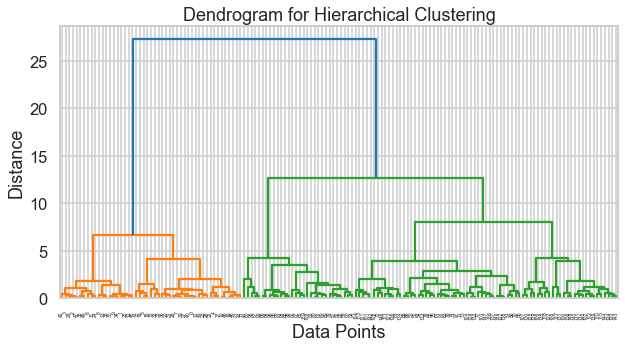

0.5817500491982808


In [317]:
plt.figure(figsize=(10, 5))
linked = sch.linkage(X_scaled, method="ward")  # Use "ward" for a clear dendrogram
sch.dendrogram(linked)
plt.title("Dendrogram for Hierarchical Clustering")
plt.xlabel("Data Points")
plt.ylabel("Distance")
plt.show()
print(best_sil)

In [ ]:
# Even after scaling the problem still persists and the data is divided into 2 clusters ...
# instead of 3
# No trial yielded a 3 cluster result that was good enough. Happened twice and each time the ...
# 3rd cluster was just 2 points

## DBSCAN without scaling

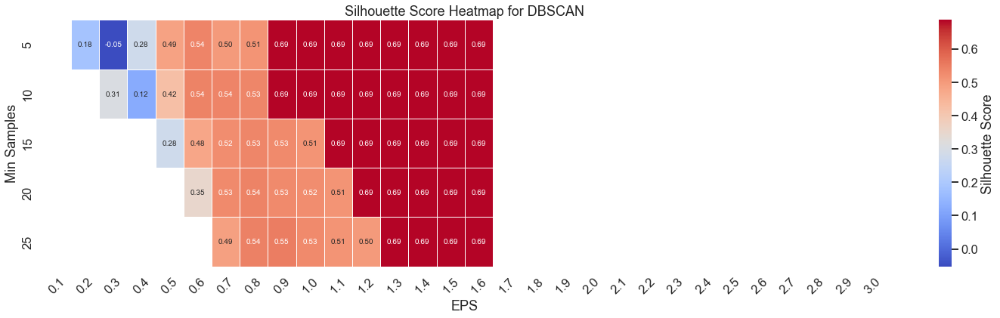


Best Parameters:
EPS: 0.900, Min Samples: 5, Clusters: 2
Best Silhouette Score: 0.6867351


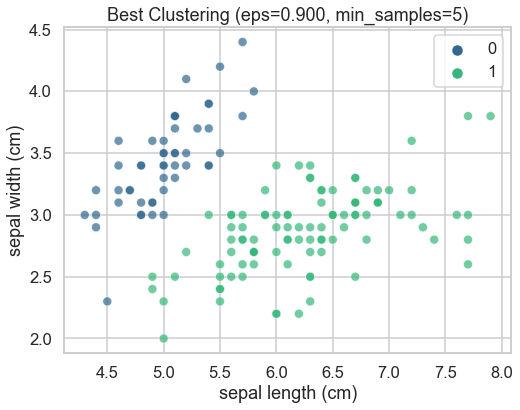

In [318]:
eps_values = np.arange(0.1, 3.1, 0.1)
min_samples_values = np.arange(5, 30, 5)
X = iris_df[iris_data.feature_names]

output = []
best_score = -1
best_params = None

for eps in eps_values:
    for min_samples in min_samples_values:
        model = DBSCAN(eps=eps, min_samples=min_samples)
        labels = model.fit_predict(X)
        n_clusters = len(set(labels) - {-1})

        if n_clusters > 1:
            silhouette = silhouette_score(X, labels)
            output.append((eps, min_samples, silhouette, n_clusters))

            # Update best score
            if silhouette > best_score:
                best_score = silhouette
                best_params = (eps, min_samples, n_clusters)

            # Print each iteration's results
            #print(f"eps: {eps:.2f}, min_samples: {min_samples}, Clusters: {n_clusters}, Silhouette Score: {silhouette:.4f}")

output = np.array(output, dtype=object)

data = np.full((len(min_samples_values), len(eps_values)), np.nan)

for i, min_samples in enumerate(min_samples_values):
    for j, eps in enumerate(eps_values):
        match = output[(output[:, 0] == eps) & (output[:, 1] == min_samples)]
        if len(match) > 0:
            data[i, j] = match[0, 2]
            
plt.figure(figsize=(25, 6))
ax = sns.heatmap(data, xticklabels=np.round(eps_values, 3),
                 yticklabels=min_samples_values, cmap="coolwarm", annot=True,
                 fmt=".2f", linewidths=0.5, cbar_kws={'label': 'Silhouette Score'})

plt.xlabel("EPS")
plt.ylabel("Min Samples")
plt.xticks(rotation=45)
plt.title("Silhouette Score Heatmap for DBSCAN")
plt.show()

print("\nBest Parameters:")
print(f"EPS: {best_params[0]:.3f}, Min Samples: {best_params[1]}, Clusters: {best_params[2]}")
print(f"Best Silhouette Score: {best_score:.7f}")

best_eps, best_min_samples, _ = best_params
best_model = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_model.fit_predict(X)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=X.iloc[:, 0], y=X.iloc[:, 1], hue=best_labels, palette='viridis', alpha=0.7)
plt.title(f"Best Clustering (eps={best_eps:.3f}, min_samples={best_min_samples})")
plt.legend()
plt.show()

In [313]:
# DBScan suffered the same problem and could not figure a way to separate Versicolor and Virginica
# Eps values beyond 1.6 yields 0 clusters so increasing the range will not work

## DBSCAN with scaling

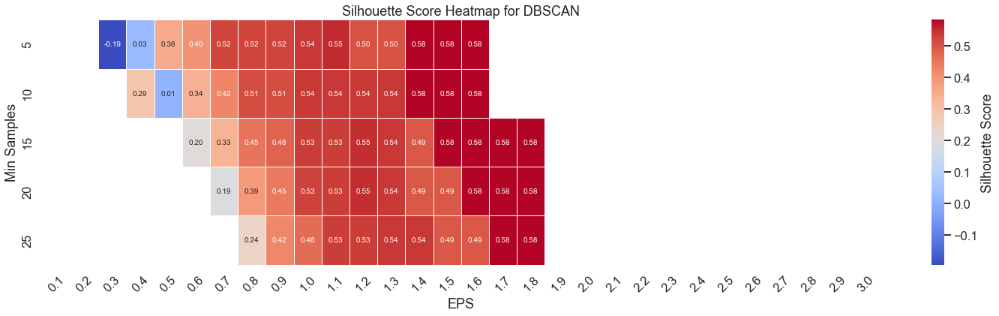


Best Parameters:
EPS: 1.400, Min Samples: 5, Clusters: 2
Best Silhouette Score: 0.5818


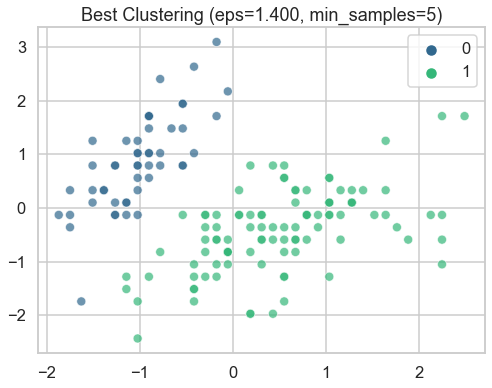

In [311]:
X = iris_df[iris_data.feature_names]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

eps_values = np.arange(0.1, 3.1, 0.1)
min_samples_values = np.arange(5, 30, 5)

output = []
best_score = -1
best_params = None

for eps in eps_values:
    for min_samples in min_samples_values:
        model = DBSCAN(eps=eps, min_samples=min_samples)
        labels = model.fit_predict(X_scaled)
        n_clusters = len(set(labels) - {-1})

        if n_clusters > 1:
            silhouette = silhouette_score(X_scaled, labels)
            output.append((eps, min_samples, silhouette, n_clusters))

            # Update best score
            if silhouette > best_score:
                best_score = silhouette
                best_params = (eps, min_samples, n_clusters)

            # Print each iteration's results
            #print(f"eps: {eps:.2f}, min_samples: {min_samples}, Clusters: {n_clusters}, Silhouette Score: {silhouette:.4f}")

output = np.array(output, dtype=object)

data = np.full((len(min_samples_values), len(eps_values)), np.nan)

for i, min_samples in enumerate(min_samples_values):
    for j, eps in enumerate(eps_values):
        match = output[(output[:, 0] == eps) & (output[:, 1] == min_samples)]
        if len(match) > 0:
            data[i, j] = match[0, 2]
            
plt.figure(figsize=(25, 6))
ax = sns.heatmap(data, xticklabels=np.round(eps_values, 3),
                 yticklabels=min_samples_values, cmap="coolwarm", annot=True,
                 fmt=".2f", linewidths=0.5, cbar_kws={'label': 'Silhouette Score'})

plt.xlabel("EPS")
plt.ylabel("Min Samples")
plt.xticks(rotation=45)
plt.title("Silhouette Score Heatmap for DBSCAN")
plt.show()

print("\nBest Parameters:")
print(f"EPS: {best_params[0]:.3f}, Min Samples: {best_params[1]}, Clusters: {best_params[2]}")
print(f"Best Silhouette Score: {best_score:.4f}")

best_eps, best_min_samples, _ = best_params
best_model = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_model.fit_predict(X_scaled)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=X_scaled[:, 0], y=X_scaled[:, 1], hue=best_labels, palette='viridis', alpha=0.7)
plt.title(f"Best Clustering (eps={best_eps:.3f}, min_samples={best_min_samples})")
plt.legend()
plt.show()

In [ ]:
# Scaling did not solve the problem

In [ ]:
"""

By comparing the silhouette score of each trial:

K-means (not scaled, scaled) = (0.6810461692117462, 0.5817500491982808)
Agglomerative (not scaled, scaled) = (0.6867350732769777, 0.5817500491982808)
DBScan (not scaled, scaled) = (0.0.6867351, 0.5818)

They all produced similar silhouette scores with the best being unscaled DBScan. Scaling caused the
silhouette score to decrease in all cases. This is probably because the distance between clusters
decrease causing the silhouette score to decrease.
All 3 algorithms produced 2 clusters insteas of 2. This is probably because of the dataset shape.

"""

## Customer dataset
Repeat all the above on the customer data set 

In [198]:
cdf = pd.read_csv(r'Customer data.csv')

In [199]:
cdf.head()

,ID,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,100000001,0,0,67,2,124670,1,2
1,100000002,1,1,22,1,150773,1,2
2,100000003,0,0,49,1,89210,0,0
3,100000004,0,0,45,1,171565,1,1
4,100000005,0,0,53,1,149031,1,1


In [201]:
cdf = cdf.fillna(0)
cdf = pd.get_dummies(cdf)
cdf.head()

,ID,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,100000001,0,0,67,2,124670,1,2
1,100000002,1,1,22,1,150773,1,2
2,100000003,0,0,49,1,89210,0,0
3,100000004,0,0,45,1,171565,1,1
4,100000005,0,0,53,1,149031,1,1


In [265]:
scaler = StandardScaler()
scaled_cdf = scaler.fit_transform(cdf)
scaled_cdf = pd.DataFrame(scaled_cdf, columns=cdf.columns)
scaled_cdf = scaled_cdf.drop(cdf.columns[0], axis=1)
scaled_cdf.head()

,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,-0.917399,-0.993024,2.653614,1.604323,0.097524,0.296823,1.552326
1,1.090038,1.007025,-1.187132,-0.063372,0.782654,0.296823,1.552326
2,-0.917399,-0.993024,1.117316,-0.063372,-0.833202,-1.269525,-0.909730
3,-0.917399,-0.993024,0.775916,-0.063372,1.328386,0.296823,0.321298
4,-0.917399,-0.993024,1.458716,-0.063372,0.736932,0.296823,0.321298


## K-Means

In [222]:
from sklearn.decomposition import PCA

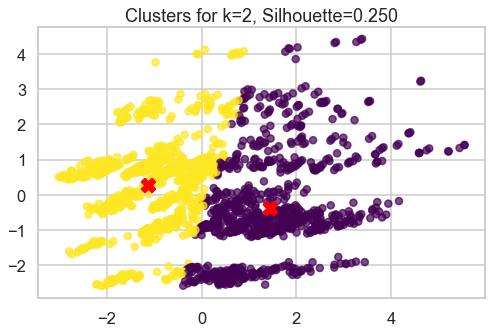

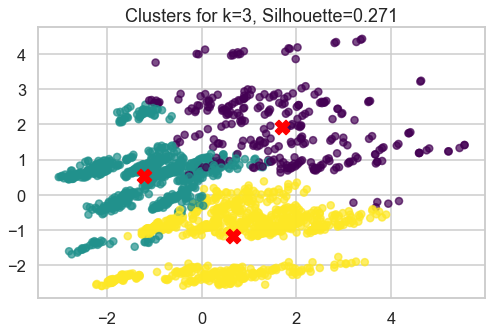

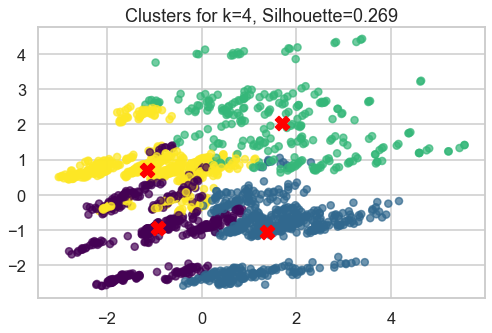

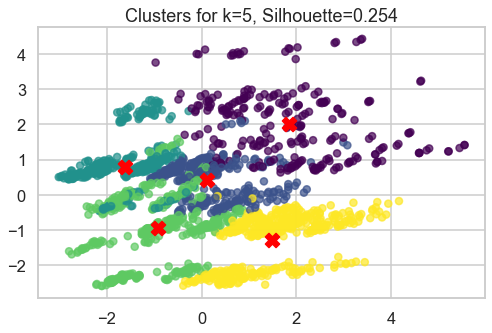

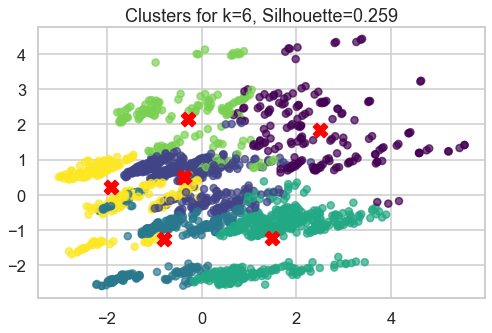

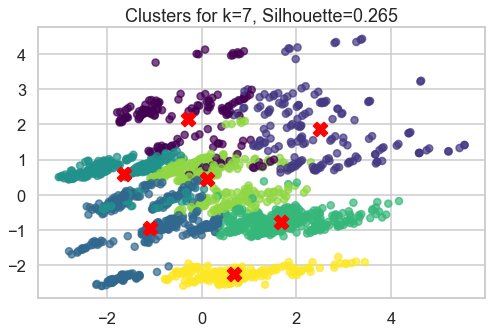

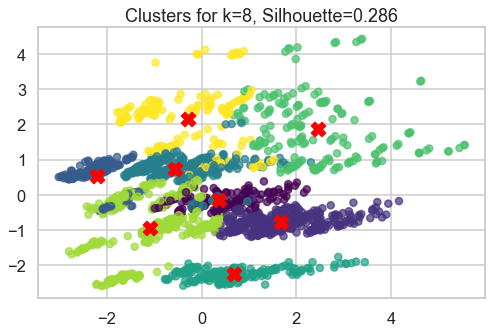

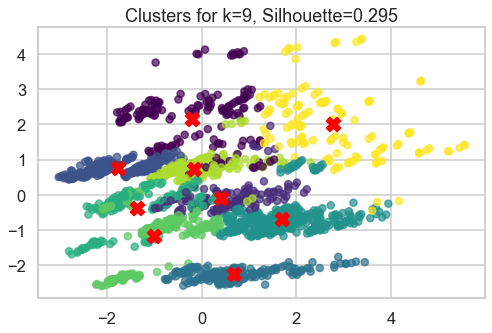

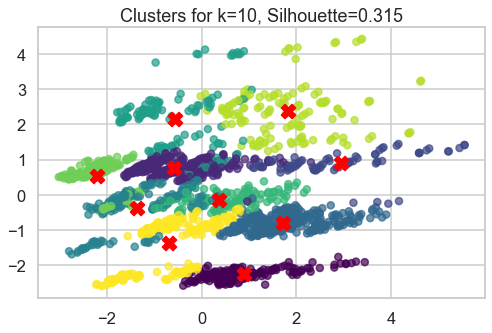

In [321]:
ssd = []
s=[]
best=-1
best_n=1

pca = PCA(n_components=2)
pca_result = pca.fit_transform(scaled_cdf)

for k in range(2,11):
    
    model = KMeans(n_clusters=k)
    model.fit(scaled_cdf)
    silhouette=silhouette_score(scaled_cdf,model.labels_)#,metric='euclidean')
    s.append(silhouette)
    
    if silhouette >= best:
        best_n=k
        best =silhouette 
    
    #Sum of squared distances of samples to their closest cluster center.
    ssd.append(model.inertia_)
    
    plt.figure(figsize=(8, 5))
    plt.scatter(pca_result[:, 0], pca_result[:, 1], c=model.labels_, cmap='viridis', s=50, alpha=0.7)
    centers = pca.transform(model.cluster_centers_)
    plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, marker='X')
    plt.title(f'Clusters for k={k}, Silhouette={silhouette:.3f}')
    plt.show()

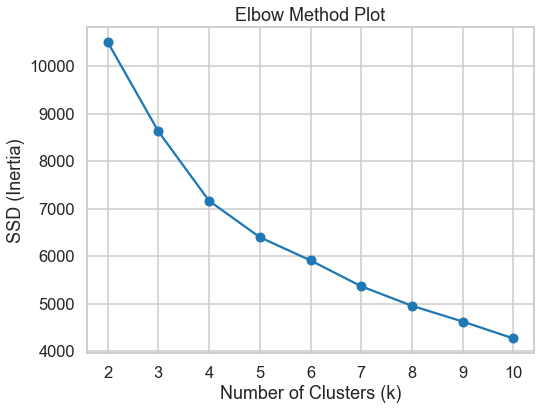

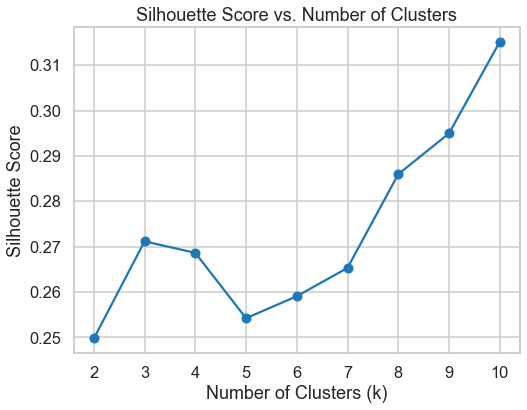

0.3151143558658902


In [323]:
# Optionally, plot the Elbow Method plot (SSD vs. k).
plt.figure(figsize=(8, 6))
plt.plot(np.arange(2,11), ssd, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("SSD (Inertia)")
plt.title("Elbow Method Plot")
plt.show()

# Optionally, plot the silhouette scores vs. k.
plt.figure(figsize=(8, 6))
plt.plot(np.arange(2,11), s, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score vs. Number of Clusters")
plt.show()
print(best)

In [ ]:
# The silhouette score shows that 10 clusters were optimum
# Best silhouette was 0.3151143558658902

## Agglomerative clustering

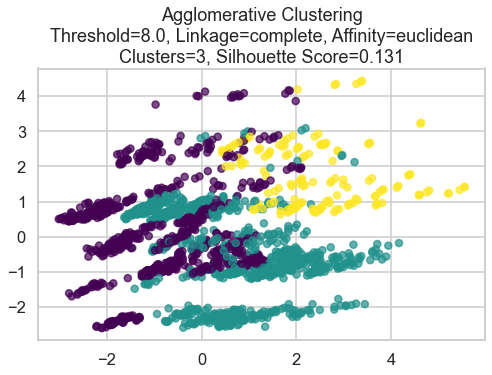

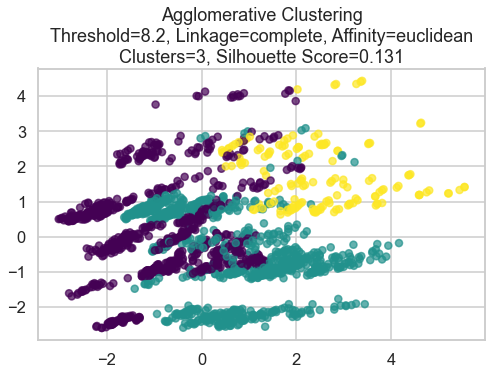

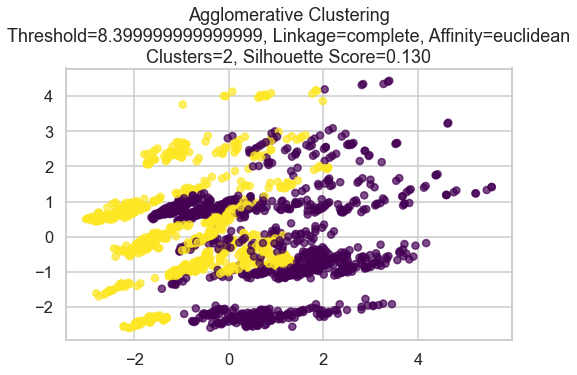

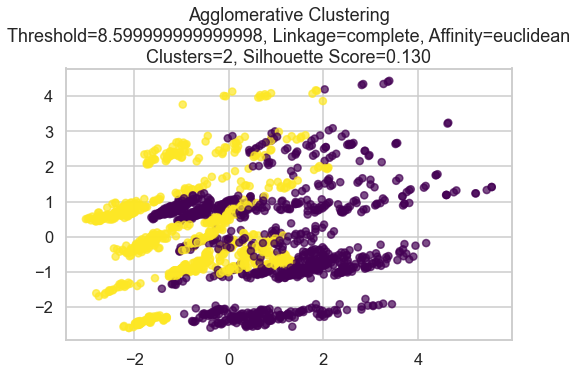

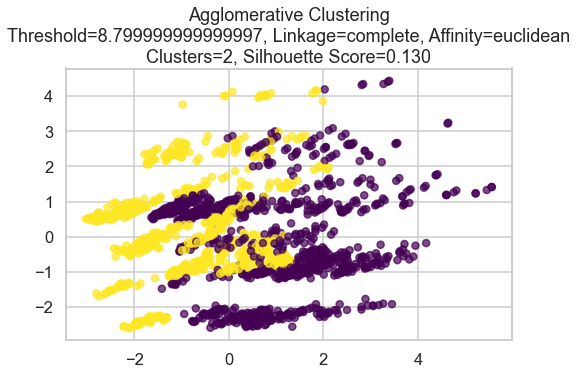

...

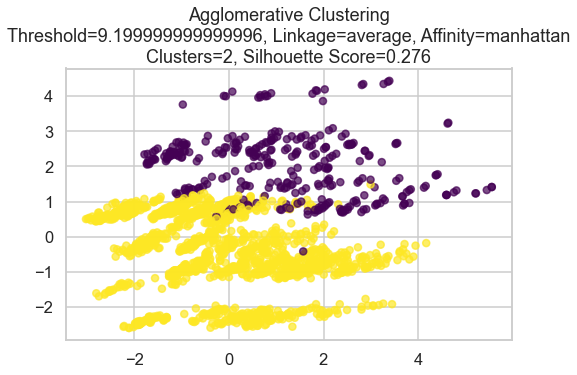

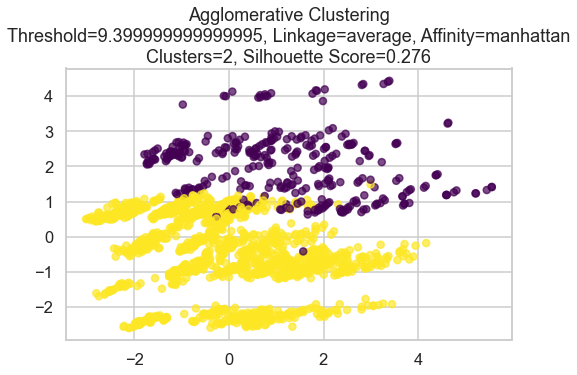

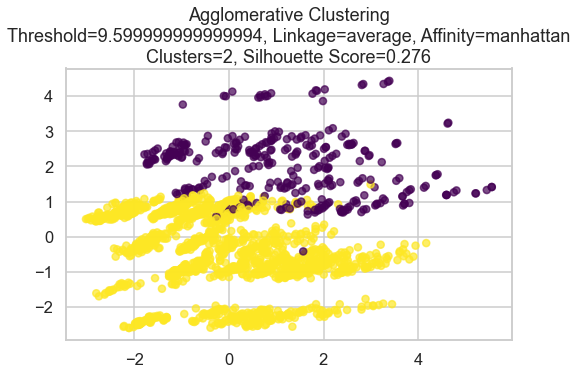

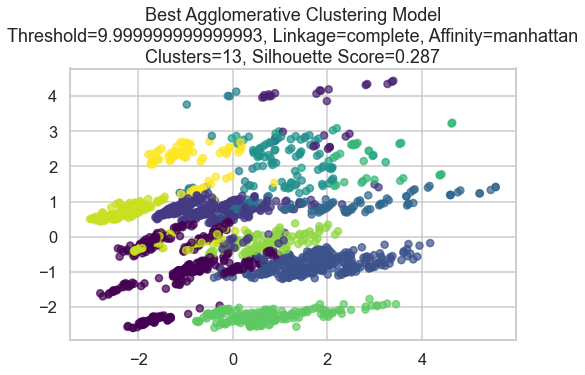

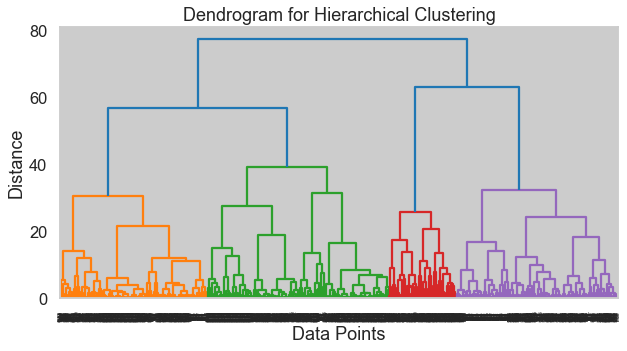

In [324]:
# Define parameters to vary
thresholds = np.arange(8, 13, 0.2)  # Distance thresholds to try
linkages = ['ward', 'complete', 'average', 'single']
affinities = ['euclidean', 'manhattan']

# Variables to track the best combination
best_sil = -1
best_threshold = None
best_linkage = None
best_affinity = None

pca = PCA(n_components=2)
pca_result = pca.fit_transform(scaled_cdf)

# Loop over each combination of linkage and affinity
for linkage in linkages:
    for affinity in affinities:
        # For ward linkage, affinity must be euclidean
        if linkage == 'ward' and affinity != 'euclidean':
            continue

        sil_scores_list = []  # To track silhouette scores for each threshold for this combination

        # Loop over the defined distance thresholds
        for thresh in thresholds:
            # Set up AgglomerativeClustering with the current parameters.
            # When distance_threshold is set, n_clusters must be None.
            model = AgglomerativeClustering(distance_threshold=thresh, n_clusters=None,
                                            linkage=linkage, affinity=affinity)
            model.fit(scaled_cdf)
            labels = model.labels_
            n_clusters = np.unique(labels).size
            
            if n_clusters < 2 or n_clusters > 15:
                continue
            
            # Compute silhouette score only if more than one cluster is formed
            if n_clusters > 1:
                sil = silhouette_score(scaled_cdf, labels)
            else:
                sil = -1
            sil_scores_list.append(sil)
            
            # Update best parameters if the current silhouette score is the best so far
            if sil > best_sil:
                best_sil = sil
                best_threshold = thresh
                best_linkage = linkage
                best_affinity = affinity
                
            plt.figure(figsize=(8, 5))
            plt.scatter(pca_result[:, 0], pca_result[:, 1], c=labels, cmap='viridis', s=50, alpha=0.7)
            plt.title(f'Agglomerative Clustering\n'
                      f'Threshold={thresh}, Linkage={linkage}, Affinity={affinity}\n'
                      f'Clusters={n_clusters}, Silhouette Score={sil:.3f}')
            plt.show()
        
best_model = AgglomerativeClustering(distance_threshold=best_threshold, n_clusters=None,
                                     linkage=best_linkage, affinity=best_affinity)
best_model.fit(scaled_cdf)
best_labels = best_model.labels_
n_clusters_best = np.unique(best_labels).size

plt.figure(figsize=(8, 5))
plt.scatter(pca_result[:, 0], pca_result[:, 1], c=best_labels, cmap='viridis', s=50, alpha=0.7)
plt.title(f'Best Agglomerative Clustering Model\n'
          f'Threshold={best_threshold}, Linkage={best_linkage}, Affinity={best_affinity}\n'
          f'Clusters={n_clusters_best}, Silhouette Score={best_sil:.3f}')
plt.show()

plt.figure(figsize=(10, 5))
linked = sch.linkage(scaled_cdf, method="ward")  # Use "ward" for a clear dendrogram
sch.dendrogram(linked)
plt.title("Dendrogram for Hierarchical Clustering")
plt.xlabel("Data Points")
plt.ylabel("Distance")
plt.show()

In [ ]:
# Agglomerative clustering yielded silhouette score of 0.287 dividing the data into 13 clusters
# A limit was put onto the number of clusters to ignore results of 1 cluster and more than 15.
# The distance threshold range was adjusted as too small distance resulted in too many clusters
# A trial was done to see how the k-means algorithm's silhouette score changes as the number of ...
# clusters increase

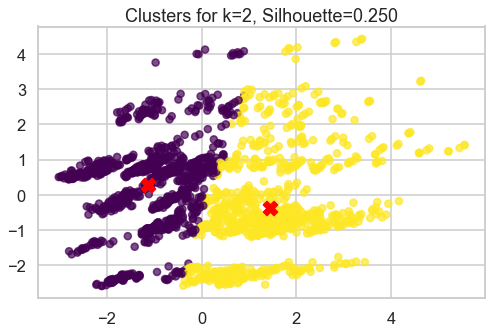

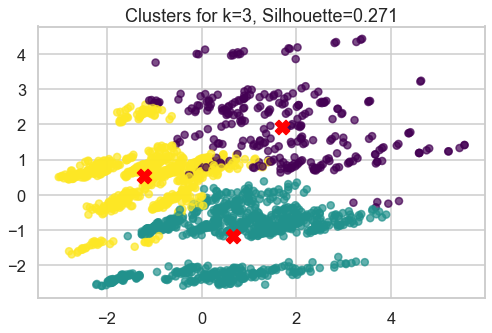

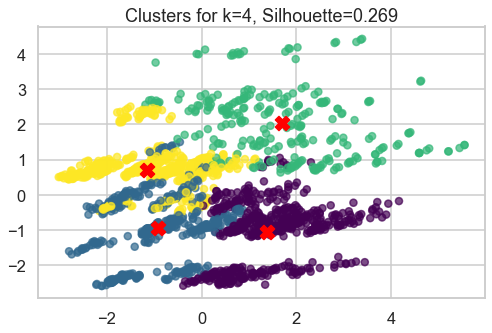

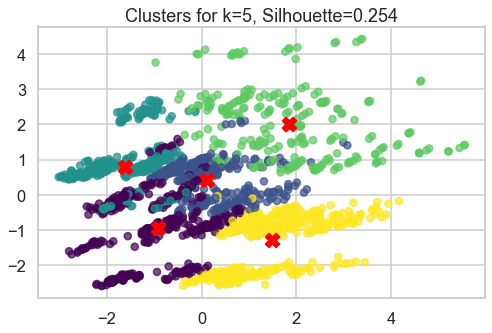

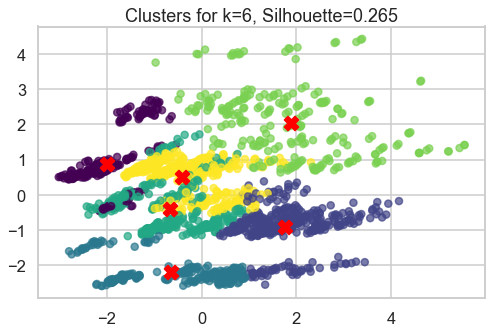

...

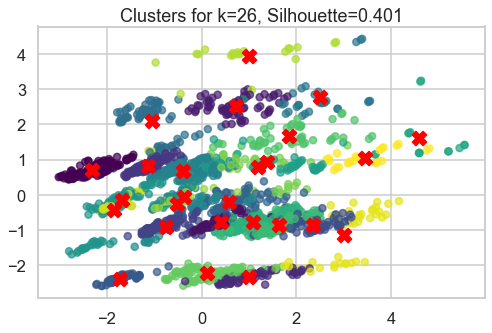

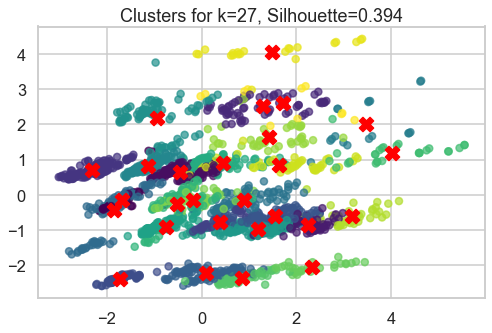

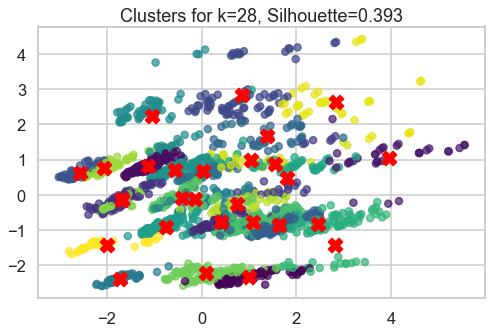

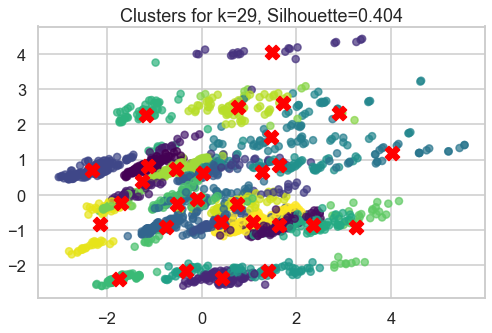

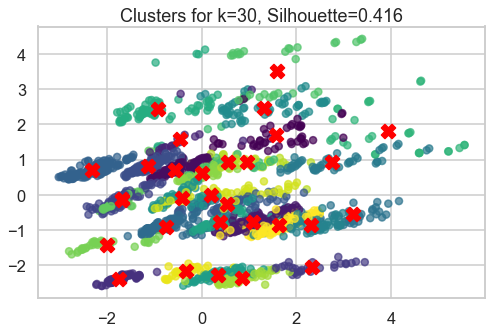

In [328]:
ssd = []
s=[]
best=-1
best_n=1

pca = PCA(n_components=2)
pca_result = pca.fit_transform(scaled_cdf)

for k in range(2,31):
    
    model = KMeans(n_clusters=k)
    model.fit(scaled_cdf)
    silhouette=silhouette_score(scaled_cdf,model.labels_)#,metric='euclidean')
    s.append(silhouette)
    
    if silhouette >= best:
        best_n=k
        best =silhouette 
    
    #Sum of squared distances of samples to their closest cluster center.
    ssd.append(model.inertia_)
    
    plt.figure(figsize=(8, 5))
    plt.scatter(pca_result[:, 0], pca_result[:, 1], c=model.labels_, cmap='viridis', s=50, alpha=0.7)
    centers = pca.transform(model.cluster_centers_)
    plt.scatter(centers[:, 0], centers[:, 1], c='red', s=200, marker='X')
    plt.title(f'Clusters for k={k}, Silhouette={silhouette:.3f}')
    plt.show()

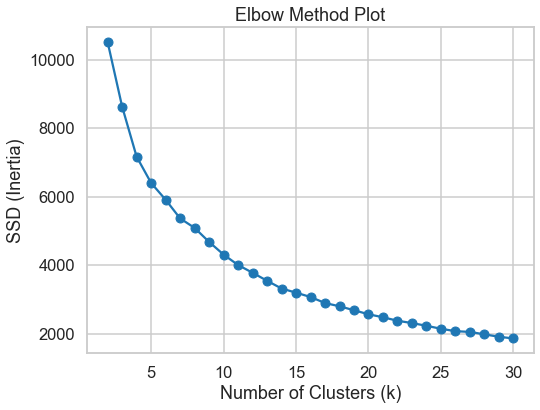

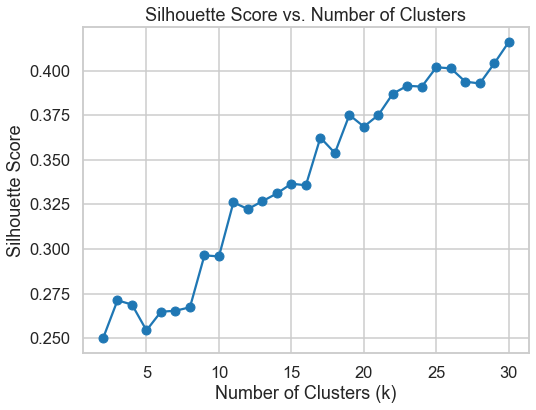

0.41613647475751897


In [330]:
# Optionally, plot the Elbow Method plot (SSD vs. k).
plt.figure(figsize=(8, 6))
plt.plot(np.arange(2,31), ssd, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("SSD (Inertia)")
plt.title("Elbow Method Plot")
plt.show()

# Optionally, plot the silhouette scores vs. k.
plt.figure(figsize=(8, 6))
plt.plot(np.arange(2,31), s, marker='o', linestyle='-')
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score vs. Number of Clusters")
plt.show()
print(best)

In [ ]:
# The silhouette score kept increasing.
# Increasing the number of clusters indefintly is a sign of overfitting where each cluster is very ...
# small and close to other clusters it loses all meaning
# this showed that putting a limit on number of clusters beneficial

## DBSCAN

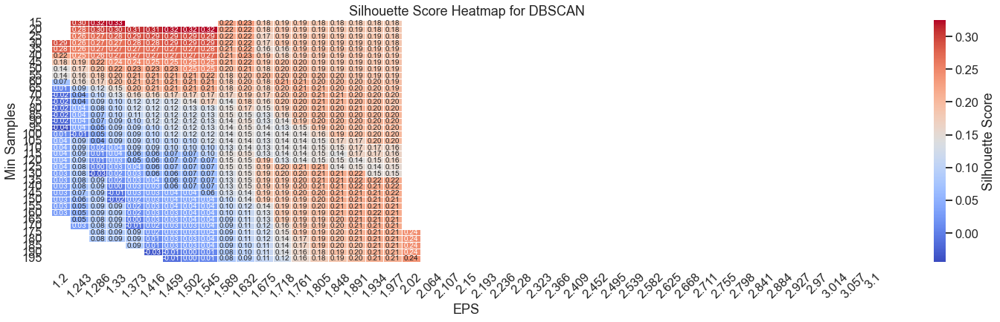


Best Parameters:
EPS: 1.330, Min Samples: 15, Clusters: 20
Best Silhouette Score: 0.325786


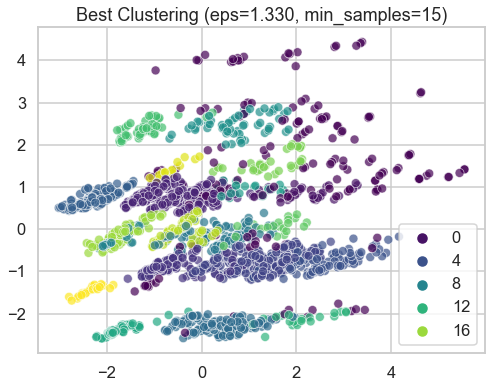

In [325]:
eps_values = np.linspace(1.2, 3.1, 45)
min_samples_values = np.arange(15, 200, 5)

output = []
best_score = -1
best_params = None

pca = PCA(n_components=2)
pca_result = pca.fit_transform(scaled_cdf)

for eps in eps_values:
    for min_samples in min_samples_values:
        model = DBSCAN(eps=eps, min_samples=min_samples)
        labels = model.fit_predict(scaled_cdf)
        n_clusters = len(set(labels) - {-1})
        
        if n_clusters < 2 or n_clusters > 20:
            continue

        if n_clusters > 1:
            silhouette = silhouette_score(scaled_cdf, labels)
            output.append((eps, min_samples, silhouette, n_clusters))

            # Update best score
            if silhouette > best_score:
                best_score = silhouette
                best_params = (eps, min_samples, n_clusters)

            # Print each iteration's results
            #print(f"eps: {eps:.2f}, min_samples: {min_samples}, Clusters: {n_clusters}, Silhouette Score: {silhouette:.4f}")

output = np.array(output, dtype=object)

data = np.full((len(min_samples_values), len(eps_values)), np.nan)

for i, min_samples in enumerate(min_samples_values):
    for j, eps in enumerate(eps_values):
        match = output[(output[:, 0] == eps) & (output[:, 1] == min_samples)]
        if len(match) > 0:
            data[i, j] = match[0, 2]
            
plt.figure(figsize=(25, 6))
ax = sns.heatmap(data, xticklabels=np.round(eps_values, 3),
                 yticklabels=min_samples_values, cmap="coolwarm", annot=True,
                 fmt=".2f", linewidths=0.5, cbar_kws={'label': 'Silhouette Score'})

plt.xlabel("EPS")
plt.ylabel("Min Samples")
plt.xticks(rotation=45)
plt.title("Silhouette Score Heatmap for DBSCAN")
plt.show()

print("\nBest Parameters:")
print(f"EPS: {best_params[0]:.3f}, Min Samples: {best_params[1]}, Clusters: {best_params[2]}")
print(f"Best Silhouette Score: {best_score:.6f}")

best_eps, best_min_samples, _ = best_params
best_model = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_labels = best_model.fit_predict(scaled_cdf)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=pca_result[:, 0], y=pca_result[:, 1], hue=best_labels, palette='viridis', alpha=0.7)
plt.title(f"Best Clustering (eps={best_eps:.3f}, min_samples={best_min_samples})")
plt.legend()
plt.show()

In [ ]:
# DBScan yielded 20 clusters as the best result with a silhouette score of 0.325786

In [ ]:
"""

By comparing the silhouette score of each trial:

K-means = 0.3151143558658902
Agglomerative = 0.287
DBScan = 0.325786

DBScan with 20 clusters showed the best silhouette score

"""